In [3]:
from typing import Tuple
from PIL import Image
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from pathlib import Path
from torch.utils.data import Dataset, DataLoader


import torch
import torch.optim as optim
import torchvision.transforms as transforms
import numpy as np
import torch.nn.functional as F
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import matplotlib as plt
import zipfile
import requests
import io
import re
from sklearn.metrics import classification_report


import os

In [82]:
flicker_dir = Path("../data/flicker")
augmented_dir = Path("../data/augmented")
augmented_dir_no = Path("../data/augmented_no")
augmented_dir_2 = Path("../data/augmented_2")

flicker_dir.mkdir(parents=True, exist_ok=True)
augmented_dir.mkdir(parents=True, exist_ok=True)
data_dir = Path("../data/final_dataset")
data_dir_noaug = Path("../data/final_dataset_noaug2")

In [83]:
def get_label(filename: str):
    return filename.split("_")[0]


def get_uuid(filename: str):
    name = Path(filename).stem          
    parts = name.split("_")
    return "_".join(parts[:2])          


def build_augmented_path(img_path: Path, base_dir: Path):
    img_path = Path(img_path)
    filename = img_path.name
    label = get_label(filename)
    uuid = get_uuid(filename)
    pres = "_".join(filename.split(".")[0].split("_")[1:3])
    return base_dir / uuid / pres / filename


def make_class_names(dataset):
    # dataset.class_to_idx: {label_str: idx}
    idx_to_class = {v: k for k, v in dataset.class_to_idx.items()}
    return [idx_to_class[i] for i in range(len(idx_to_class))]


def count_oov_pct(sequences, oov_id):
    total = sum(1 for seq in sequences for tid in seq if tid != 0)
    oov = sum(1 for seq in sequences for tid in seq if tid == oov_id)
    return oov/total*100 if total > 0 else 0

class_to_idx = {
    "ball":  0,
    "bike":  1,
    "dog":   2,
    "water": 3,
}

class_names = ["ball", "bike", "dog", "water"]

metadata_path = Path("../data/final_dataset/metadata.csv")
metadata_path_noaug = Path("../data/final_dataset_noaug2/metadata.csv")

df = pd.read_csv(metadata_path)
df_noaug= pd.read_csv(metadata_path_noaug)

print(df.columns)
print(df.iloc[1])

Index(['image_path', 'label', 'caption'], dtype='object')
image_path                             new_ball_683_spatial.jpg
label                                                Label.BALL
caption       Two black dogs, their fur fluffed up in agitat...
Name: 1, dtype: object


In [84]:
from torchvision import transforms

transform = transforms.Compose(
    [transforms.Resize((300, 500)),
        transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

transform_resnet = transforms.Compose([
    transforms.Resize((224, 224)), 
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    )
])

class ImageCLIPDataset(Dataset):
    def __init__(self, imgs, labels, captions,  base_dir: Path, transform):
        
        self.img_paths = [Path(build_augmented_path(img, base_dir)) for img in imgs]
        self.labels = list(labels)
        self.captions = list(captions)
        self.transform = transform
        self.classes = sorted(set(self.labels))                  
        self.class_to_idx = {cls: i for i, cls in enumerate(self.classes)}  


    def __getitem__(self, idx):
        img = Image.open(self.img_paths[idx]).convert("RGB")

        label_str = self.labels[idx]
        label = self.class_to_idx[label_str]
        caption = self.captions[idx] if self.captions is not None else "-"

        if self.transform:
            img = self.transform(img)

        return idx, img, label, caption
    
    def __len__(self) -> int:
        return len(self.img_paths)
    
    def _get_img_path_from_idx(self, idx: int) -> Path:
        return self.img_paths[idx]

    def _get_caption_from_idx(self, idx: int) -> Path:
        return self.captions[idx]
    
    def _get_label_from_idx(self, idx: int) -> str :
        return self.labels[idx]
    
    def _get_img_size(self, idx: int) -> Tuple[int, int]:
        print(self.img_paths[idx])

        img = Image.open(self.img_paths[idx]).convert("RGB")
        if self.transform:
            for t in self.transform.transforms:
                if isinstance(t, transforms.Resize):
                    img = t(img)
        return img.height, img.width

    
    
    

        


In [85]:
X =  df["image_path"]
X_noaug = df_noaug["image_path"]
print(X)

0                new_ball_683.jpg
1        new_ball_683_spatial.jpg
2          new_ball_683_color.jpg
3                new_ball_196.jpg
4        new_ball_196_spatial.jpg
                  ...            
4195    base_ball_031_spatial.jpg
4196      base_ball_031_color.jpg
4197            base_ball_137.jpg
4198    base_ball_137_spatial.jpg
4199      base_ball_137_color.jpg
Name: image_path, Length: 4200, dtype: object


In [86]:

df_train, df_temp = train_test_split(df, test_size=0.3, random_state=11)
df_test, df_val = train_test_split(df_temp, test_size=0.5, random_state=11)

df_train_noaug, df_temp_noaug = train_test_split(df_noaug, test_size=0.3, random_state=11)
df_test_noaug, df_val_noaug = train_test_split(df_temp_noaug, test_size=0.5, random_state=11)

print(len(df_train), len(df_test), len(df_val))
print(df_train["label"].value_counts(normalize=True) * 100)
print(df_val["label"].value_counts(normalize=True) * 100)
print(df_test["label"].value_counts(normalize=True) * 100)
print("-----\n")

print(len(df_train_noaug), len(df_test_noaug), len(df_val_noaug))
print(df_train["label"].value_counts(normalize=True) * 100)
print(df_val["label"].value_counts(normalize=True) * 100)
print(df_test["label"].value_counts(normalize=True) * 100)



2940 630 630
label
Label.BALL     25.782313
Label.WATER    24.897959
Label.DOG      24.761905
Label.BIKE     24.557823
Name: proportion, dtype: float64
label
Label.WATER    26.666667
Label.DOG      25.079365
Label.BALL     24.285714
Label.BIKE     23.968254
Name: proportion, dtype: float64
label
Label.BIKE     28.095238
Label.DOG      26.031746
Label.WATER    23.809524
Label.BALL     22.063492
Name: proportion, dtype: float64
-----

980 210 210
label
Label.BALL     25.782313
Label.WATER    24.897959
Label.DOG      24.761905
Label.BIKE     24.557823
Name: proportion, dtype: float64
label
Label.WATER    26.666667
Label.DOG      25.079365
Label.BALL     24.285714
Label.BIKE     23.968254
Name: proportion, dtype: float64
label
Label.BIKE     28.095238
Label.DOG      26.031746
Label.WATER    23.809524
Label.BALL     22.063492
Name: proportion, dtype: float64


In [87]:
X_train, y_train, train_caption = df_train["image_path"], df_train["label"], df_train["caption"]
X_val, y_val, val_caption = df_val["image_path"], df_val["label"], df_val["caption"]
X_test, y_test, test_caption   = df_test["image_path"], df_test["label"], df_test["caption"]

X_train_noaug, y_train_noaug, train_caption_noaug = df_train_noaug["image_path"], df_train_noaug["label"], df_train_noaug["caption"]
X_val_noaug, y_val_noaug, val_caption_noaug = df_val_noaug["image_path"], df_val_noaug["label"], df_val_noaug["caption"]
X_test_noaug, y_test_noaug, test_caption_noaug   = df_test_noaug["image_path"], df_test_noaug["label"], df_test_noaug["caption"]


In [88]:
X_train = X_train.reset_index(drop=True)
y_train = y_train.reset_index(drop=True)
X_val = X_val.reset_index(drop=True)
y_val = y_val.reset_index(drop=True)
X_test = X_test.reset_index(drop=True)
y_test = y_test.reset_index(drop=True)
train_caption = train_caption.reset_index(drop=True)
test_caption = test_caption.reset_index(drop=True)
val_caption = val_caption.reset_index(drop=True)

X_train_noaug = X_train_noaug.reset_index(drop=True)
y_train_noaug = y_train_noaug.reset_index(drop=True)
X_val_noaug = X_val_noaug.reset_index(drop=True)
y_val_noaug = y_val_noaug.reset_index(drop=True)
X_test_noaug = X_test_noaug.reset_index(drop=True)
y_test_noaug = y_test_noaug.reset_index(drop=True)
train_caption_noaug = train_caption_noaug.reset_index(drop=True)
test_caption_noaug = test_caption_noaug.reset_index(drop=True)
val_caption_noaug = val_caption_noaug.reset_index(drop=True)

In [89]:
train_dataset_resnet = ImageCLIPDataset(X_train, y_train, train_caption, data_dir, transform_resnet)
val_dataset_resnet   = ImageCLIPDataset(X_val, y_val, val_caption, data_dir, transform_resnet)
test_dataset_resnet  = ImageCLIPDataset(X_test, y_test, test_caption,  data_dir, transform_resnet)

train_dataset_custom = ImageCLIPDataset(X_train, y_train, train_caption, data_dir, transform)
val_dataset_custom   = ImageCLIPDataset(X_val, y_val, val_caption, data_dir, transform)
test_dataset_custom  = ImageCLIPDataset(X_test, y_test, test_caption, data_dir, transform)

train_dataset_resnet_noaug = ImageCLIPDataset(X_train_noaug, y_train_noaug, train_caption_noaug, data_dir_noaug, transform_resnet)
val_dataset_resnet_noaug   = ImageCLIPDataset(X_val_noaug, y_val_noaug, val_caption_noaug, data_dir_noaug, transform_resnet)
test_dataset_resnet_noaug  = ImageCLIPDataset(X_test_noaug, y_test_noaug, test_caption_noaug,  data_dir_noaug, transform_resnet)

train_dataset_custom_noaug = ImageCLIPDataset(X_train_noaug, y_train_noaug, train_caption_noaug, data_dir, transform)
val_dataset_custom_noaug   = ImageCLIPDataset(X_val_noaug, y_val_noaug, val_caption, data_dir_noaug, transform)
test_dataset_custom_noaug  = ImageCLIPDataset(X_test_noaug, y_test_noaug, test_caption, data_dir_noaug, transform)



../data/final_dataset/base_bike/bike_025/base_bike_025.jpg
(224, 224)
../data/final_dataset/new_dog/dog_1013/new_dog_1013_color.jpg
(224, 224)


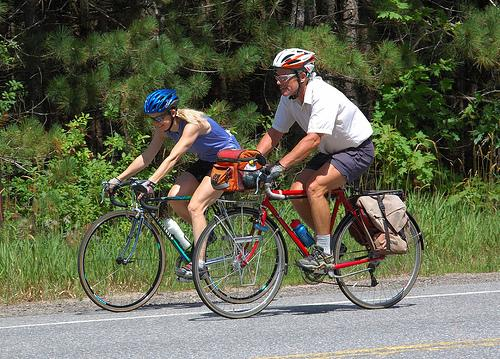

(3, tensor([[[-1.7069, -1.9980, -1.9124,  ..., -1.4329, -1.3302, -1.7583],
         [-1.5699, -1.6727, -1.6898,  ..., -0.8678, -0.9363, -1.6727],
         [-1.0390, -1.0733, -1.1418,  ...,  0.0398, -1.0048, -1.5699],
         ...,
         [ 0.8618,  1.0502,  0.9646,  ...,  0.9988,  0.9646,  1.0844],
         [ 0.7762,  0.9303,  0.9817,  ...,  1.0331,  0.9817,  0.8104],
         [ 0.7933,  0.9817,  0.9474,  ...,  1.1529,  1.0159,  0.8276]],

        [[-1.3880, -1.7381, -1.7031,  ..., -1.3880, -1.2829, -1.7206],
         [-1.2304, -1.3704, -1.4580,  ..., -0.7402, -0.8277, -1.5805],
         [-0.6527, -0.7577, -0.9328,  ...,  0.2752, -0.8277, -1.3880],
         ...,
         [ 1.0630,  1.2556,  1.1681,  ...,  1.2031,  1.1856,  1.3081],
         [ 0.9755,  1.1331,  1.1856,  ...,  1.2381,  1.2031,  1.0280],
         [ 0.9930,  1.1856,  1.1506,  ...,  1.3431,  1.2381,  1.0455]],

        [[-1.4559, -1.7522, -1.6824,  ..., -1.2990, -1.2467, -1.6476],
         [-1.3513, -1.4733, -1.5081,  ...

In [90]:
print(train_dataset_resnet._get_img_size(3))
print(train_dataset_resnet._get_img_size(13))
img = train_dataset_resnet._get_img_path_from_idx(3)
lg = Image.open(build_augmented_path(img, data_dir))
display(lg)
print(train_dataset_resnet.__getitem__(3))

In [91]:
train_loader_resnet = DataLoader(train_dataset_resnet, batch_size=32, shuffle=True)
val_loader_resnet   = DataLoader(val_dataset_resnet, batch_size=32, shuffle=False)
test_loader_resnet  = DataLoader(test_dataset_resnet, batch_size=32, shuffle=False)

train_loader_custom = DataLoader(train_dataset_custom, batch_size=32, shuffle=True)
val_loader_custom   = DataLoader(val_dataset_custom, batch_size=32, shuffle=False)
test_loader_custom  = DataLoader(test_dataset_custom, batch_size=32, shuffle=False)

train_loader_resnet_noaug = DataLoader(train_dataset_resnet_noaug, batch_size=32, shuffle=True)
val_loader_resnet_noaug   = DataLoader(val_dataset_resnet_noaug, batch_size=32, shuffle=False)
test_loader_resnet_noaug  = DataLoader(test_dataset_resnet_noaug, batch_size=32, shuffle=False)

train_loader_custom_noaug = DataLoader(train_dataset_custom_noaug, batch_size=32, shuffle=True)
val_loader_custom_noaug   = DataLoader(val_dataset_custom_noaug, batch_size=32, shuffle=False)
test_loader_custom_noaug  = DataLoader(test_dataset_custom_noaug, batch_size=32, shuffle=False)




### MODEL IMPLEMENTATION

In [69]:
class CNNBasic(nn.Module):
    def __init__(self, num_classes=4):
        super().__init__()

        self.features = nn.Sequential(
            nn.Conv2d(3, 16, 3, padding=1), nn.BatchNorm2d(16), nn.ReLU(), nn.MaxPool2d(2,2),
            nn.Conv2d(16, 32, 3, padding=1), nn.BatchNorm2d(32), nn.ReLU(), nn.MaxPool2d(2,2),
            nn.Conv2d(32, 64, 3, padding=1), nn.BatchNorm2d(64), nn.ReLU(), nn.MaxPool2d(2,2)
        )

        self.flattened_size = self._get_flattened_size()

        self.classifier = nn.Sequential(
            nn.Linear(self.flattened_size, 256),
            nn.ReLU(),
            nn.Dropout(0.4),
            nn.Linear(256, num_classes)
        )

    def _get_flattened_size(self):
        with torch.no_grad():
            x = torch.randn(1, 3, 300, 500)
            x = self.features(x)
            return x.view(1, -1).shape[1]

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)
        return self.classifier(x)


In [70]:
import torch
import torch.nn as nn

class CNNBasicV2(nn.Module):
    def __init__(self, num_classes=4):
        super().__init__()

        def block(in_ch, out_ch, pool=True):
            layers = [
                nn.Conv2d(in_ch, out_ch, kernel_size=3, padding=1, bias=False),
                nn.BatchNorm2d(out_ch),
                nn.ReLU(inplace=True),
            ]
            if pool:
                layers.append(nn.MaxPool2d(2))
            return nn.Sequential(*layers)

        self.features = nn.Sequential(
            block(3, 32, pool=True),    # 300x500 -> 150x250
            block(32, 64, pool=True),   # -> 75x125
            block(64, 128, pool=True),  # -> 37x62
            block(128, 256, pool=False) # pas de pool ici (garde un peu de spatial)
        )

        # Dropout sur feature maps (souvent meilleur que dropout sur FC pour CNN)
        self.dropout = nn.Dropout2d(p=0.2)

        # Global Average Pooling => [B, 256, 1, 1]
        self.gap = nn.AdaptiveAvgPool2d((1, 1))

        # Classifier léger (beaucoup moins de paramètres que ton Linear géant)
        self.classifier = nn.Sequential(
            nn.Linear(256, 128),
            nn.ReLU(inplace=True),
            nn.Dropout(p=0.3),
            nn.Linear(128, num_classes)
        )

    def forward(self, x):
        x = self.features(x)
        x = self.dropout(x)
        x = self.gap(x).flatten(1)  # [B, 256]
        return self.classifier(x)


### RESNET IMPLEMENTATION

In [71]:
from torchvision.models import resnet18, ResNet18_Weights
class ResNet18EarlyExit(nn.Module):
    def __init__(self, num_classes=4, threshold=0.9):
        super().__init__()
        self.threshold = threshold

        base = resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)

        self.stem = nn.Sequential(
            base.conv1, base.bn1, base.relu, base.maxpool
        )
        self.layer1 = base.layer1
        self.layer2 = base.layer2
        self.layer3 = base.layer3
        self.layer4 = base.layer4
        
        self.exit1 = self._make_exit(64, num_classes)
        self.exit2 = self._make_exit(128, num_classes)
        self.exit3 = self._make_exit(256, num_classes)
        self.exit4 = nn.Linear(base.fc.in_features, num_classes)

    def _make_exit(self, channels, num_classes):
        return nn.Sequential(
            nn.AdaptiveAvgPool2d((1,1)),
            nn.Flatten(),
            nn.Linear(channels, num_classes)
        )
    def extract_features(self, x):
        features = {}

        x = self.stem(x)
        x = self.layer1(x)
        f1 = torch.flatten(nn.AdaptiveAvgPool2d((1,1))(x), 1)
        features["exit1"] = f1

        x = self.layer2(x)
        f2 = torch.flatten(nn.AdaptiveAvgPool2d((1,1))(x), 1)
        features["exit2"] = f2

        x = self.layer3(x)
        f3 = torch.flatten(nn.AdaptiveAvgPool2d((1,1))(x), 1)
        features["exit3"] = f3

        x = self.layer4(x)
        f4 = torch.flatten(nn.AdaptiveAvgPool2d((1,1))(x), 1)
        features["exit4"] = f4

        return features
    def forward(self, x):
        x = self.stem(x)
        x = self.layer1(x)
        out1 = self.exit1(x)
        if self._confident(out1):
            return out1
        
        x = self.layer2(x)
        out2 = self.exit2(x)
        if self._confident(out2):
            return out2
        
        x = self.layer3(x)
        out3 = self.exit3(x)
        if self._confident(out3):
            return out3
        
        x = self.layer4(x)
        x = nn.AdaptiveAvgPool2d((1,1))(x)
        x = torch.flatten(x, 1)
        out4 = self.exit4(x)
        return out4, 4

    def _confident(self, logits):
        probs = logits.softmax(dim=1)
        max_conf = probs.max(dim=1).values
        return (max_conf > self.threshold).any()


### GRAD CAM

In [72]:
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

class GradCAM:
    """
    Grad-CAM for a given model + target layer.
    Works for CNNs that output logits [B, num_classes].
    """
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer

        self.activations = None
        self.gradients = None

        self._fwd_handle = target_layer.register_forward_hook(self._forward_hook)
        self._bwd_handle = target_layer.register_full_backward_hook(self._backward_hook)

    def _forward_hook(self, module, inp, out):
        self.activations = out.detach()

    def _backward_hook(self, module, grad_in, grad_out):
        # grad_out is a tuple; grad_out[0] shape == activations shape
        self.gradients = grad_out[0].detach()

    def remove(self):
        self._fwd_handle.remove()
        self._bwd_handle.remove()

    def __call__(self, x, class_idx=None):
        """
        x: Tensor [1, C, H, W]
        class_idx: int or None -> if None, uses predicted class
        returns: cam (H', W') in [0,1], pred_class, probs
        """
        self.model.zero_grad(set_to_none=True)
        logits = self.model(x)  # [1, num_classes]
        probs = torch.softmax(logits, dim=1)

        pred_class = int(probs.argmax(dim=1).item())
        target_class = pred_class if class_idx is None else int(class_idx)

        score = logits[0, target_class]
        score.backward(retain_graph=False)

        # activations: [1, K, H', W'], gradients: [1, K, H', W']
        grads = self.gradients[0]      # [K, H', W']
        acts = self.activations[0]     # [K, H', W']

        # Global-average-pool gradients over spatial dims -> weights [K]
        weights = grads.mean(dim=(1, 2))  # [K]

        # Weighted sum of activations
        cam = (weights[:, None, None] * acts).sum(dim=0)  # [H', W']
        cam = F.relu(cam)

        # Normalize to [0,1]
        cam -= cam.min()
        cam /= (cam.max() + 1e-8)

        return cam.cpu().numpy(), pred_class, probs.detach().cpu().numpy()[0]

def get_last_conv_layer(model):
    last_conv = model.features[8]  # dernière Conv2d
    return last_conv


### TRAINING AND VALIDATION METHODS

In [73]:
def ensure_dir(path: Path) -> None:
    path.mkdir(parents=True, exist_ok=True)

def make_class_names(dataset):
    # dataset.class_to_idx: {label_str: idx}
    idx_to_class = {v: k for k, v in dataset.class_to_idx.items()}
    return [idx_to_class[i] for i in range(len(idx_to_class))]


def to_device(x, device):
    return x.to(device, non_blocking=True)


def train_one_epoch(model, loader, optimizer, criterion, device, epoch, epochs):
    model.train()
    running_loss = 0.0

    loop = tqdm(
        enumerate(loader, 0),
        total=len(loader),
        desc=f"Epoch {epoch+1}/{epochs} [TRAIN]"
    )

    for i, data in loop:
        idx, inputs, labels, caption = data
        inputs = to_device(inputs, device)
        labels = to_device(labels, device)


        optimizer.zero_grad(set_to_none=True)
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        loop.set_postfix(loss=running_loss / (i + 1))

    avg_loss = running_loss / len(loader)
    return avg_loss


@torch.no_grad()
def evaluate(
    model,
    loader,
    criterion,
    device,
    epoch,
    epochs,
    num_classes,
    dataset=None,                 
    class_names=None,             
    caption_fn=None,              
    n_mistakes_to_print=5
):
    model.eval()
    running_loss = 0.0

    all_labels = []
    all_preds = []
    all_probs = []

    mistakes_printed = 0

    loop = tqdm(loader, desc=f"Epoch {epoch+1}/{epochs} [EVAL]")

    for batch in loop:
        idxs, inputs, labels, captions = batch
        inputs = inputs.to(device)
        labels = labels.to(device)

      
        logits = model(inputs)
        loss = criterion(logits, labels)
        running_loss += loss.item()

        probs = torch.softmax(logits, dim=1)
        preds = probs.argmax(dim=1)

        all_labels.append(labels)
        all_preds.append(preds)
        all_probs.append(probs)


        can_print_mistakes = (dataset is not None) and (class_names is not None)
        if can_print_mistakes and mistakes_printed < n_mistakes_to_print:
            mism_mask = (preds != labels).detach().cpu()
            if mism_mask.any():
                mism_positions = torch.where(mism_mask)[0].tolist()
                for pos in mism_positions:
                    if mistakes_printed >= n_mistakes_to_print:
                        break

                    sample_idx = int(idxs[pos].item())  # idx du dataset
                    true_i = int(labels[pos].item())
                    pred_i = int(preds[pos].item())

                    true_name = class_names[true_i]
                    pred_name = class_names[pred_i]

                    img_path = dataset._get_img_path_from_idx(sample_idx)
                    display(Image.open(img_path).convert('RGB'))
                    # si tu as une caption, via callback; sinon on affiche "-"
                    caption = dataset._get_caption_from_idx(sample_idx)

                    print("\n--- Mauvaise prédiction ---")
                    print(f"dataset_idx : {sample_idx}")
                    print(f"image      : {img_path}")
                    print(f"vrai label : {true_name} ({true_i})")
                    print(f"prédit     : {pred_name} ({pred_i})")
                    print(f"caption    : {caption}")

                    mistakes_printed += 1

    avg_loss = running_loss / len(loader)

    all_labels = torch.cat(all_labels)
    all_preds = torch.cat(all_preds)
    all_probs = torch.cat(all_probs)

    accuracy = (all_preds == all_labels).float().mean().item()

    return (
        avg_loss,
        all_labels.cpu().numpy(),
        all_preds.cpu().numpy(),
        all_probs.cpu().numpy(),
        accuracy
    )

@torch.no_grad()
def evaluate_while_training(
    model,
    loader,
    criterion,
    device,
    epoch,
    epochs,
):
    model.eval()
    running_loss = 0.0

    all_labels = []
    all_preds = []
    all_probs = []

    mistakes_printed = 0

    loop = tqdm(loader, desc=f"Epoch {epoch+1}/{epochs} [EVAL]")

    for batch in loop:
        idxs, inputs, labels, captions = batch
        inputs = inputs.to(device)
        labels = labels.to(device)

      
        logits = model(inputs)
        loss = criterion(logits, labels)
        running_loss += loss.item()

        probs = torch.softmax(logits, dim=1)
        preds = probs.argmax(dim=1)

        all_labels.append(labels)
        all_preds.append(preds)
        all_probs.append(probs)

    avg_loss = running_loss / len(loader)

    all_labels = torch.cat(all_labels)
    all_preds = torch.cat(all_preds)
    all_probs = torch.cat(all_probs)

    accuracy = (all_preds == all_labels).float().mean().item()

    return (
        avg_loss,
        all_labels.cpu().numpy(),
        all_preds.cpu().numpy(),
        all_probs.cpu().numpy(),
        accuracy
    )


In [74]:
import matplotlib.pyplot as plt
from sklearn.metrics import (
    classification_report,
    confusion_matrix,
    ConfusionMatrixDisplay,
    roc_curve,
    auc
)
from sklearn.preprocessing import label_binarize
def plot_losses(train_losses, test_losses):
    plt.figure(figsize=(8, 5))
    plt.plot(train_losses, label="Train loss")
    plt.plot(test_losses, label="Test loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Training vs Test Loss")
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    plt.show()
def plot_losses(train_losses, test_losses):
    plt.figure(figsize=(8, 5))
    plt.plot(train_losses, label="Train loss")
    plt.plot(test_losses, label="Test loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Training vs Test Loss")
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    plt.show()


def plot_confusion_matrix(y_true, y_pred, class_names=None, title="Confusion Matrix"):
    cm = confusion_matrix(y_true, y_pred)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    disp.plot(cmap="Blues", values_format="d", xticks_rotation=45)
    plt.title(title)
    plt.tight_layout()
    plt.show()


def plot_multiclass_roc(y_true, y_prob, num_classes, class_names=None, title="ROC (One-vs-Rest)"):
    """
    y_true: [N] int labels
    y_prob: [N, C] probabilities
    """
    y_true_bin = label_binarize(y_true, classes=list(range(num_classes)))  # [N, C]

    plt.figure(figsize=(8, 6))
    for c in range(num_classes):
        fpr, tpr, _ = roc_curve(y_true_bin[:, c], y_prob[:, c])
        roc_auc = auc(fpr, tpr)
        name = class_names[c] if class_names is not None else f"Class {c}"
        plt.plot(fpr, tpr, label=f"{name} (AUC={roc_auc:.3f})")

    # Diagonal
    plt.plot([0, 1], [0, 1], linestyle="--")
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title(title)
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    plt.show()

In [75]:
def fit(
    model,
    train_loader,
    test_loader,
    num_classes=4,
    epochs=50,
    lr=1e-3,
    momentum=0.9,
    patience=5,
    models_dir=Path("../models"),
    best_name="best_model.pth",
    criterion=None,
    class_names=None,
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = model.to(device)

    if criterion is None:
        criterion = nn.CrossEntropyLoss()


    optimizer = optim.SGD(model.parameters(), lr=lr, momentum=momentum)

    ensure_dir(models_dir)
    best_model_path = models_dir / best_name

    best_test_loss = float("inf")
    patience_counter = 0

    train_losses = []
    test_losses = []

    for epoch in range(epochs):
        train_loss = train_one_epoch(
            model, train_loader, optimizer, criterion, device, epoch, epochs
        )
        train_losses.append(train_loss)
        print(f"\nEpoch {epoch+1} - Average TRAIN loss: {train_loss:.4f}")

        test_loss, y_true, y_pred, y_prob, acc = evaluate_while_training(
            model, test_loader, criterion, device, epoch, epochs
        )
        test_losses.append(test_loss)

        print(f"Epoch {epoch+1} - Average TEST loss: {test_loss:.4f}")
        print("\nClassification Report:")
        print(classification_report(y_true, y_pred, digits=3))

        # Early stopping + save best
        if test_loss < best_test_loss:
            best_test_loss = test_loss
            patience_counter = 0
            torch.save(model.state_dict(), best_model_path)
            print(f"Nouveau meilleur modèle sauvegardé (test loss: {best_test_loss:.4f})")
        else:
            patience_counter += 1
            print(f"Pas d'amélioration ({patience_counter}/{patience})")
            if patience_counter >= patience:
                print(f"\nEarly stopping déclenché après {epoch+1} époques")
                print(f"Meilleur test loss: {best_test_loss:.4f}")
                break

    # Load best model + final evaluation for plots
    print(f"\nChargement du meilleur modèle (test loss: {best_test_loss:.4f})")
    model.load_state_dict(torch.load(best_model_path, map_location=device))

    final_test_loss, y_true, y_pred, y_prob, acc = evaluate(
        model, test_loader, criterion, device, epoch=0, epochs=1, num_classes=num_classes
    )
    print(f"Best model - TEST loss: {final_test_loss:.4f}")

    # Plots
    plot_losses(train_losses, test_losses)
    plot_confusion_matrix(y_true, y_pred, class_names=class_names, title="Confusion Matrix (Best Model)")
    plot_multiclass_roc(y_true, y_prob, num_classes=num_classes, class_names=class_names, title="ROC (Best Model, OvR)")
    return model, {"train_losses": train_losses, "test_losses": test_losses, "best_test_loss": best_test_loss}


In [76]:
def denorm_05(t):
    # t: Tensor [3,H,W] in [-1,1]
    return (t * 0.5 + 0.5).clamp(0, 1)

def show_cam_overlay(img_tensor, cam, title="Grad-CAM"):
    """
    img_tensor: [3,H,W] (normalized), cam: [H',W'] from GradCAM
    """
    img = denorm_05(img_tensor).permute(1,2,0).cpu().numpy()  # [H,W,3]

    # Resize cam to image size
    cam_t = torch.tensor(cam)[None, None, ...]  # [1,1,H',W']
    cam_resized = F.interpolate(cam_t, size=img.shape[:2], mode="bilinear", align_corners=False)
    cam_resized = cam_resized[0,0].cpu().numpy()

    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)
    plt.imshow(img)
    plt.axis("off")
    plt.title("Image")

    plt.subplot(1,2,2)
    plt.imshow(img)
    plt.imshow(cam_resized, alpha=0.45)  # overlay
    plt.axis("off")
    plt.title(title)

    plt.tight_layout()
    plt.show()


In [77]:
import torch
import torch.nn.functional as F

def show_5_mistakes_with_gradcam(
    model,
    loader,
    device,
    class_names,
    target_layer,          # ex: model.features[8]
    dataset=None,
    n=5
):
    model.eval()
    gc = GradCAM(model, target_layer)
    shown = 0

    for idxs, inputs, labels, captions in loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        logits = model(inputs)
        probs = torch.softmax(logits, dim=1)
        preds = probs.argmax(dim=1)

        mism = (preds != labels).detach().cpu()
        if mism.any():
            for pos in torch.where(mism)[0].tolist():
                if shown >= n:
                    gc.remove()
                    return

                sample_idx = int(idxs[pos].item())
                true_i = int(labels[pos].item())
                pred_i = int(preds[pos].item())

                true_name = class_names[true_i]
                pred_name = class_names[pred_i]
                caption = captions[pos]

                img_path = dataset._get_img_path_from_idx(sample_idx) if dataset is not None else "N/A"

                print("\n--- Mauvaise prédiction ---")
                print(f"dataset_idx : {sample_idx}")
                print(f"image      : {img_path}")
                print(f"vrai label : {true_name} ({true_i})")
                print(f"prédit     : {pred_name} ({pred_i})")
                print(f"caption    : {caption}")

                x1 = inputs[pos:pos+1].detach()
                x1.requires_grad_(True)

                cam_map, _, _ = gc(x1, class_idx=pred_i)

                show_cam_overlay(
                    inputs[pos].detach().cpu(),
                    cam_map,
                    title=f"Grad-CAM (true={true_name} pred={pred_name})"
                )

                shown += 1

    gc.remove()


In [78]:
from sklearn.manifold import TSNE

def plot_tsne(model, loader, class_names, max_samples=500):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    model.eval()
    feats = { "exit1": [], "exit2": [], "exit3": [], "exit4": [] }
    labels = []

    with torch.no_grad():
        for _, (idx, imgs, y, caption) in enumerate(loader):
            imgs = imgs.to(device)

            features = model.extract_features(imgs)
            for k in feats.keys():
                feats[k].append(features[k].cpu().numpy())

            labels.append(y.numpy())
            if len(labels) * imgs.size(0) > max_samples:
                break

    for k in feats.keys():
        X = np.concatenate(feats[k], axis=0)
        Y = np.concatenate(labels, axis=0)

        X_2d = TSNE(n_components=2, learning_rate="auto", init="pca").fit_transform(X)

        plt.figure(figsize=(6,5))
        for i, class_name in enumerate(class_names):
            pts = X_2d[Y == i]
            plt.scatter(pts[:,0], pts[:,1], s=12, label=class_name)

        plt.title(f"t-SNE — {k}")
        plt.legend()
        plt.show()

### TRAINING V2


In [79]:
class_names = make_class_names(train_dataset_custom)
class_names



['Label.BALL', 'Label.BIKE', 'Label.DOG', 'Label.WATER']

In [2]:
model = CNNBasicV2(4)  
trained_model, history = fit(
    model=model,
    train_loader=train_loader_custom,
    test_loader=test_loader_custom,
    num_classes=4,
    epochs=50,
    lr=1e-3,
    momentum=0.9,
    patience=5,
    models_dir=Path("../models"),
    best_name="best_model_v2.pth",
    criterion=nn.CrossEntropyLoss(),
    class_names=class_names,
)

NameError: name 'CNNBasicV2' is not defined

### CNN BASIC TRAINING

Epoch 1/50 [TRAIN]:   7%|▋         | 6/92 [00:01<00:24,  3.49it/s, loss=1.58]

Epoch 1/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.49it/s, loss=1.35]



Epoch 1 - Average TRAIN loss: 1.3473


Epoch 1/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.68it/s]


Epoch 1 - Average TEST loss: 1.1534

Classification Report:
              precision    recall  f1-score   support

           0      0.459     0.245     0.319       139
           1      0.614     0.610     0.612       177
           2      0.541     0.567     0.554       164
           3      0.413     0.573     0.480       150

    accuracy                          0.510       630
   macro avg      0.507     0.499     0.491       630
weighted avg      0.513     0.510     0.501       630

Nouveau meilleur modèle sauvegardé (test loss: 1.1534)


Epoch 2/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.52it/s, loss=1.17]



Epoch 2 - Average TRAIN loss: 1.1746


Epoch 2/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.58it/s]


Epoch 2 - Average TEST loss: 1.0878

Classification Report:
              precision    recall  f1-score   support

           0      0.478     0.309     0.376       139
           1      0.559     0.751     0.641       177
           2      0.503     0.561     0.530       164
           3      0.521     0.413     0.461       150

    accuracy                          0.524       630
   macro avg      0.515     0.509     0.502       630
weighted avg      0.517     0.524     0.511       630

Nouveau meilleur modèle sauvegardé (test loss: 1.0878)


Epoch 3/50 [TRAIN]: 100%|██████████| 92/92 [00:27<00:00,  3.40it/s, loss=1.07]



Epoch 3 - Average TRAIN loss: 1.0749


Epoch 3/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.65it/s]


Epoch 3 - Average TEST loss: 1.0659

Classification Report:
              precision    recall  f1-score   support

           0      0.409     0.748     0.529       139
           1      0.709     0.701     0.705       177
           2      0.500     0.244     0.328       164
           3      0.562     0.453     0.502       150

    accuracy                          0.533       630
   macro avg      0.545     0.537     0.516       630
weighted avg      0.553     0.533     0.520       630

Nouveau meilleur modèle sauvegardé (test loss: 1.0659)


Epoch 4/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.45it/s, loss=1.02] 



Epoch 4 - Average TRAIN loss: 1.0236


Epoch 4/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.71it/s]


Epoch 4 - Average TEST loss: 1.0787

Classification Report:
              precision    recall  f1-score   support

           0      0.384     0.741     0.506       139
           1      0.817     0.531     0.644       177
           2      0.524     0.402     0.455       164
           3      0.562     0.453     0.502       150

    accuracy                          0.525       630
   macro avg      0.572     0.532     0.527       630
weighted avg      0.585     0.525     0.531       630

Pas d'amélioration (1/5)


Epoch 5/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.43it/s, loss=1.03] 



Epoch 5 - Average TRAIN loss: 1.0270


Epoch 5/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.69it/s]


Epoch 5 - Average TEST loss: 0.9768

Classification Report:
              precision    recall  f1-score   support

           0      0.565     0.374     0.450       139
           1      0.615     0.831     0.707       177
           2      0.530     0.598     0.562       164
           3      0.561     0.427     0.485       150

    accuracy                          0.573       630
   macro avg      0.568     0.557     0.551       630
weighted avg      0.569     0.573     0.560       630

Nouveau meilleur modèle sauvegardé (test loss: 0.9768)


Epoch 6/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.46it/s, loss=0.914]



Epoch 6 - Average TRAIN loss: 0.9142


Epoch 6/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.62it/s]


Epoch 6 - Average TEST loss: 0.9710

Classification Report:
              precision    recall  f1-score   support

           0      0.679     0.518     0.588       139
           1      0.793     0.650     0.714       177
           2      0.655     0.579     0.615       164
           3      0.487     0.760     0.594       150

    accuracy                          0.629       630
   macro avg      0.654     0.627     0.628       630
weighted avg      0.659     0.629     0.632       630

Nouveau meilleur modèle sauvegardé (test loss: 0.9710)


Epoch 7/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.51it/s, loss=0.851]



Epoch 7 - Average TRAIN loss: 0.8508


Epoch 7/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.68it/s]


Epoch 7 - Average TEST loss: 1.0686

Classification Report:
              precision    recall  f1-score   support

           0      0.726     0.324     0.448       139
           1      0.531     0.859     0.657       177
           2      0.525     0.713     0.605       164
           3      0.627     0.247     0.354       150

    accuracy                          0.557       630
   macro avg      0.602     0.536     0.516       630
weighted avg      0.595     0.557     0.525       630

Pas d'amélioration (1/5)


Epoch 8/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.53it/s, loss=0.851]



Epoch 8 - Average TRAIN loss: 0.8506


Epoch 8/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.69it/s]


Epoch 8 - Average TEST loss: 0.9414

Classification Report:
              precision    recall  f1-score   support

           0      0.678     0.439     0.533       139
           1      0.796     0.661     0.722       177
           2      0.679     0.579     0.625       164
           3      0.486     0.820     0.610       150

    accuracy                          0.629       630
   macro avg      0.660     0.625     0.623       630
weighted avg      0.666     0.629     0.628       630

Nouveau meilleur modèle sauvegardé (test loss: 0.9414)


Epoch 9/50 [TRAIN]: 100%|██████████| 92/92 [00:25<00:00,  3.61it/s, loss=0.791]



Epoch 9 - Average TRAIN loss: 0.7908


Epoch 9/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.62it/s]


Epoch 9 - Average TEST loss: 0.8789

Classification Report:
              precision    recall  f1-score   support

           0      0.723     0.489     0.584       139
           1      0.642     0.791     0.709       177
           2      0.583     0.732     0.649       164
           3      0.661     0.493     0.565       150

    accuracy                          0.638       630
   macro avg      0.652     0.626     0.627       630
weighted avg      0.649     0.638     0.631       630

Nouveau meilleur modèle sauvegardé (test loss: 0.8789)


Epoch 10/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.50it/s, loss=0.718]



Epoch 10 - Average TRAIN loss: 0.7177


Epoch 10/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.64it/s]


Epoch 10 - Average TEST loss: 0.9982

Classification Report:
              precision    recall  f1-score   support

           0      0.711     0.388     0.502       139
           1      0.828     0.599     0.695       177
           2      0.479     0.823     0.605       164
           3      0.576     0.553     0.565       150

    accuracy                          0.600       630
   macro avg      0.648     0.591     0.592       630
weighted avg      0.651     0.600     0.598       630

Pas d'amélioration (1/5)


Epoch 11/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.51it/s, loss=0.669]



Epoch 11 - Average TRAIN loss: 0.6687


Epoch 11/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.66it/s]


Epoch 11 - Average TEST loss: 0.7989

Classification Report:
              precision    recall  f1-score   support

           0      0.723     0.619     0.667       139
           1      0.874     0.706     0.781       177
           2      0.711     0.720     0.715       164
           3      0.614     0.827     0.705       150

    accuracy                          0.719       630
   macro avg      0.730     0.718     0.717       630
weighted avg      0.736     0.719     0.720       630

Nouveau meilleur modèle sauvegardé (test loss: 0.7989)


Epoch 12/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.51it/s, loss=0.574]



Epoch 12 - Average TRAIN loss: 0.5736


Epoch 12/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.71it/s]


Epoch 12 - Average TEST loss: 0.9348

Classification Report:
              precision    recall  f1-score   support

           0      0.637     0.619     0.628       139
           1      0.707     0.819     0.759       177
           2      0.793     0.445     0.570       164
           3      0.576     0.760     0.655       150

    accuracy                          0.663       630
   macro avg      0.678     0.661     0.653       630
weighted avg      0.683     0.663     0.656       630

Pas d'amélioration (1/5)


Epoch 13/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.52it/s, loss=0.572]



Epoch 13 - Average TRAIN loss: 0.5718


Epoch 13/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.68it/s]


Epoch 13 - Average TEST loss: 0.9987

Classification Report:
              precision    recall  f1-score   support

           0      0.840     0.453     0.589       139
           1      0.767     0.706     0.735       177
           2      0.720     0.549     0.623       164
           3      0.461     0.820     0.590       150

    accuracy                          0.637       630
   macro avg      0.697     0.632     0.634       630
weighted avg      0.698     0.637     0.639       630

Pas d'amélioration (2/5)


Epoch 14/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.52it/s, loss=0.504]



Epoch 14 - Average TRAIN loss: 0.5040


Epoch 14/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.65it/s]


Epoch 14 - Average TEST loss: 0.8196

Classification Report:
              precision    recall  f1-score   support

           0      0.835     0.475     0.606       139
           1      0.706     0.802     0.751       177
           2      0.676     0.762     0.716       164
           3      0.642     0.707     0.673       150

    accuracy                          0.697       630
   macro avg      0.715     0.686     0.687       630
weighted avg      0.712     0.697     0.691       630

Pas d'amélioration (3/5)


Epoch 15/50 [TRAIN]: 100%|██████████| 92/92 [00:25<00:00,  3.58it/s, loss=0.488]



Epoch 15 - Average TRAIN loss: 0.4882


Epoch 15/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.66it/s]


Epoch 15 - Average TEST loss: 1.0001

Classification Report:
              precision    recall  f1-score   support

           0      0.896     0.309     0.460       139
           1      0.861     0.667     0.752       177
           2      0.558     0.738     0.635       164
           3      0.539     0.820     0.651       150

    accuracy                          0.643       630
   macro avg      0.714     0.633     0.624       630
weighted avg      0.713     0.643     0.633       630

Pas d'amélioration (4/5)


Epoch 16/50 [TRAIN]: 100%|██████████| 92/92 [00:26<00:00,  3.53it/s, loss=0.556]



Epoch 16 - Average TRAIN loss: 0.5563


Epoch 16/50 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.65it/s]


Epoch 16 - Average TEST loss: 0.8248

Classification Report:
              precision    recall  f1-score   support

           0      0.682     0.647     0.664       139
           1      0.822     0.706     0.760       177
           2      0.757     0.476     0.584       164
           3      0.510     0.827     0.631       150

    accuracy                          0.662       630
   macro avg      0.693     0.664     0.660       630
weighted avg      0.700     0.662     0.662       630

Pas d'amélioration (5/5)

Early stopping déclenché après 16 époques
Meilleur test loss: 0.7989

Chargement du meilleur modèle (test loss: 0.7989)


Epoch 1/1 [EVAL]: 100%|██████████| 20/20 [00:04<00:00,  4.65it/s]


Best model - TEST loss: 0.7989


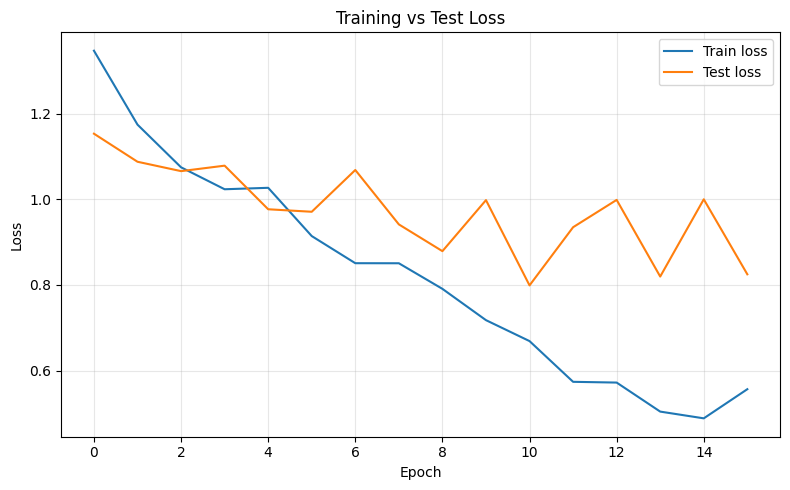

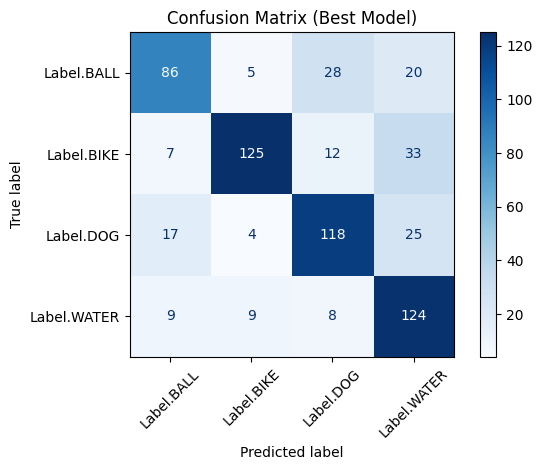

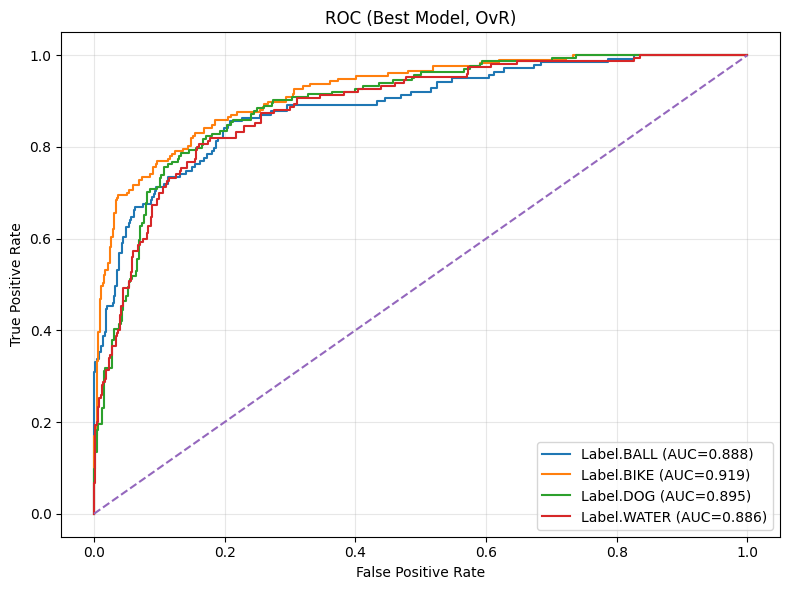

In [37]:
model = CNNBasic(4)  
trained_model, history = fit(
    model=model,
    train_loader=train_loader_custom,
    test_loader=test_loader_custom,
    num_classes=4,
    epochs=50,
    lr=1e-3,
    momentum=0.9,
    patience=5,
    models_dir=Path("../models"),
    best_name="best_model_2.pth",
    criterion=nn.CrossEntropyLoss(),
    class_names=class_names,
)

Epoch 1/1 [EVAL]:   0%|          | 0/18 [00:00<?, ?it/s]

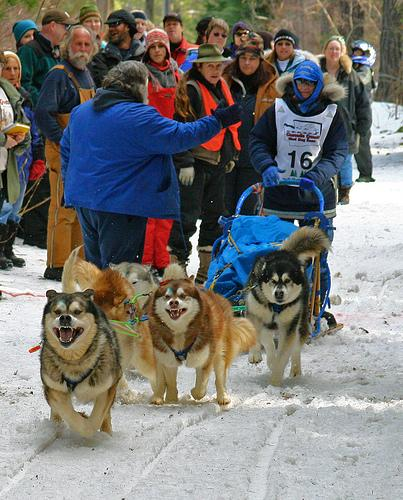


--- Mauvaise prédiction ---
dataset_idx : 68
image      : ../data/final_dataset/new_dog/dog_762/new_dog_762.jpg
vrai label : Label.DOG (2)
prédit     : Label.WATER (3)
caption    : The snow-covered track stretches out into the distance as a crowd of bundled-up spectators cheers on with enthusiasm, their breath visible in the chilly air. At the forefront of the action, a dog with a sleek coat and energetic demeanor dashes forward, its paws pounding against the ice as it gains speed alongside its handler. The sound of sled runners scraping against the snow fills the crisp winter air, accompanied by the joyful shouts of onlookers.


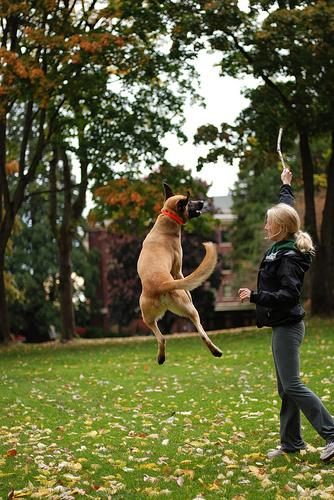


--- Mauvaise prédiction ---
dataset_idx : 460
image      : ../data/final_dataset/new_dog/dog_615/new_dog_615.jpg
vrai label : Label.DOG (2)
prédit     : Label.BALL (0)
caption    : A sunny afternoon in a park with lush green grass and tall trees, a blond woman in casual clothing laughs as she throws a stick for her energetic orange dog to catch. The dog, its fur fluffed up from excitement, leaps into the air with an acrobatic twist, its paws outstretched in pursuit of the flying stick. As the dog bounds towards it, the woman's eyes light up with delight at the joyous display of canine enthusiasm.


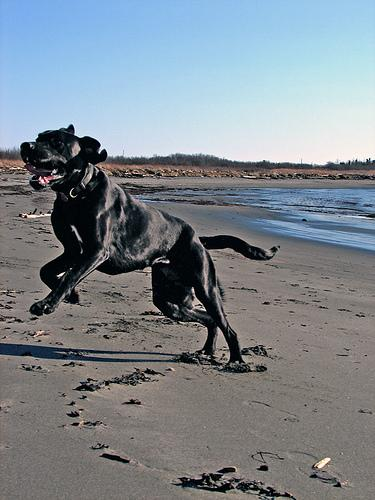


--- Mauvaise prédiction ---
dataset_idx : 44
image      : ../data/final_dataset/new_dog/dog_914/new_dog_914.jpg
vrai label : Label.DOG (2)
prédit     : Label.BIKE (1)
caption    : A playful black dog, its fur fluffed up by the sea breeze, bounds effortlessly off the sandy beach, sending waves of sand flying in all directions as it leaps into the air. The sun beats down on its back, highlighting the joyful abandon with which it pursues some unseen target, its tail wagging wildly as it catches itself mid-leap and turns to make another attempt at catching whatever has caught its attention. In the distance, a few beachgoers can be seen laughing and cheering it on.


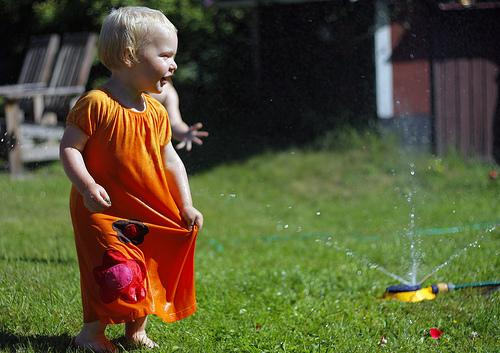

Epoch 1/1 [EVAL]:   6%|▌         | 1/18 [00:00<00:07,  2.36it/s]


--- Mauvaise prédiction ---
dataset_idx : 254
image      : ../data/final_dataset/new_water/water_1095/new_water_1095.jpg
vrai label : Label.WATER (3)
prédit     : Label.DOG (2)
caption    : A young girl plays in her backyard on a warm summer day, giggling as she tries to avoid getting soaked by the rotating sprinkler spraying cool water everywhere. Her bright orange dress gets drenched in the process, clinging to her legs and making her look like a little mermaid. The sound of the sprinkler creates a soothing melody in the background, accompanied by the chirping of birds in the nearby trees.


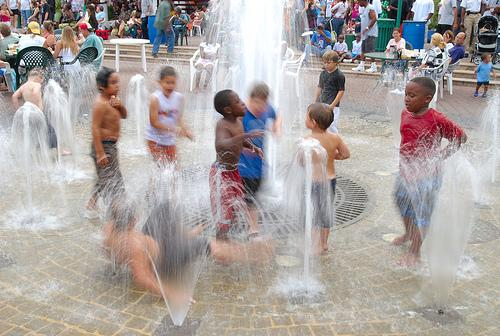

Epoch 1/1 [EVAL]:  11%|█         | 2/18 [00:00<00:05,  2.86it/s]


--- Mauvaise prédiction ---
dataset_idx : 136
image      : ../data/final_dataset/new_water/water_1215/new_water_1215.jpg
vrai label : Label.WATER (3)
prédit     : Label.DOG (2)
caption    : A group of children from diverse backgrounds gather at the center of a bustling city square, their faces filled with joy as they splash in the large fountain. The sound of laughter and splashing water fills the air as they take turns squirting each other with the water jets. In the background, busy office workers and street performers go about their daily routines, creating a vibrant and lively atmosphere amidst the cool mist of the fountain's spray.


Epoch 1/1 [EVAL]: 100%|██████████| 18/18 [00:04<00:00,  3.78it/s]


Best model - TEST loss: 0.4450
Accuracy : 0.8642857074737549



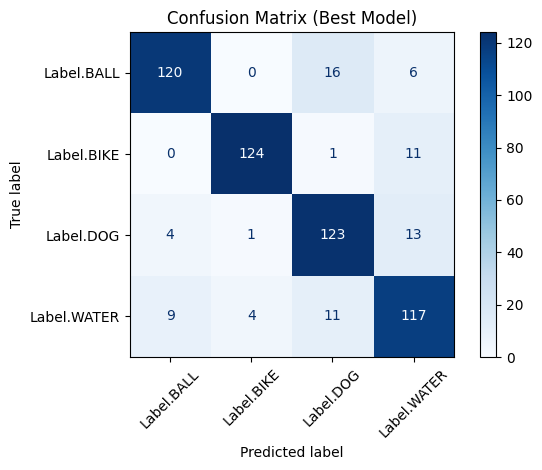

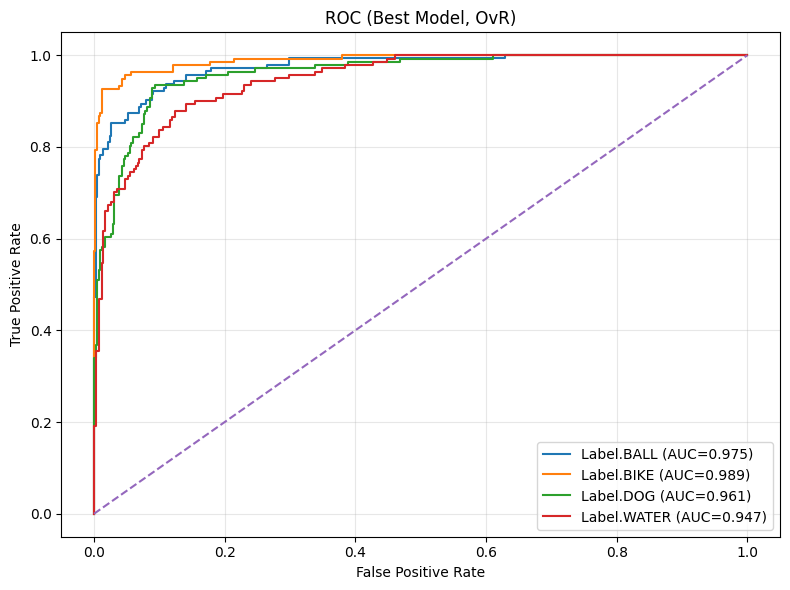

In [34]:
best_model_path = Path("../models/best_model_2.pth")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_loaded = CNNBasic(num_classes=4)
model_loaded = model_loaded.to(device)
model_loaded.load_state_dict(torch.load(best_model_path, map_location=device))
criterion = nn.CrossEntropyLoss()

final_test_loss, y_true, y_pred, y_prob, acc = evaluate(
    model_loaded, train_loader_custom_noaug, criterion, device, class_names=class_names, epoch=0, epochs=1, num_classes=4,dataset=train_dataset_custom_noaug
)
print(f"Best model - TEST loss: {final_test_loss:.4f}")
print(f"Accuracy : {acc}\n")
plot_confusion_matrix(y_true, y_pred, class_names=class_names, title="Confusion Matrix (Best Model)")
plot_multiclass_roc(y_true, y_prob, num_classes=4, class_names=class_names, title="ROC (Best Model, OvR)")


--- Mauvaise prédiction ---
dataset_idx : 68
image      : ../data/final_dataset/new_dog/dog_762/new_dog_762.jpg
vrai label : Label.DOG (2)
prédit     : Label.WATER (3)
caption    : The snow-covered track stretches out into the distance as a crowd of bundled-up spectators cheers on with enthusiasm, their breath visible in the chilly air. At the forefront of the action, a dog with a sleek coat and energetic demeanor dashes forward, its paws pounding against the ice as it gains speed alongside its handler. The sound of sled runners scraping against the snow fills the crisp winter air, accompanied by the joyful shouts of onlookers.


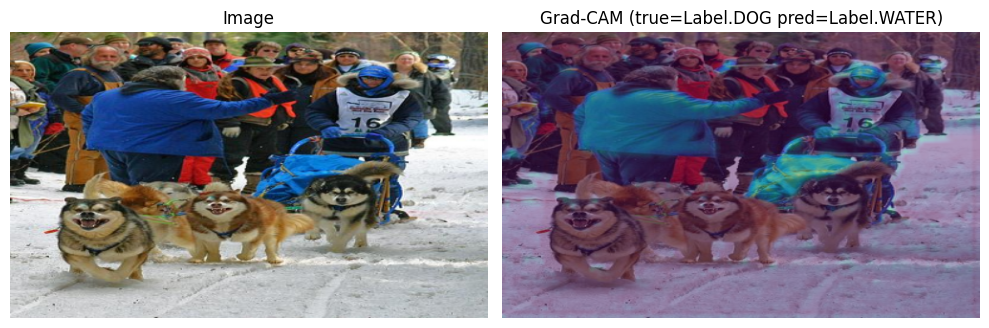


--- Mauvaise prédiction ---
dataset_idx : 270
image      : ../data/final_dataset/new_ball/ball_725/new_ball_725.jpg
vrai label : Label.BALL (0)
prédit     : Label.DOG (2)
caption    : A playful black and white dog, its fur fluffed up from excitement, runs eagerly across the vast open grassy plane, its eyes fixed intently on a brightly colored ball bouncing ahead of it. The sun casts a warm glow over the scene, illuminating the dog's joyful expression as it gives chase. In the distance, the rolling hills stretch out, providing a serene backdrop to the lively pursuit.


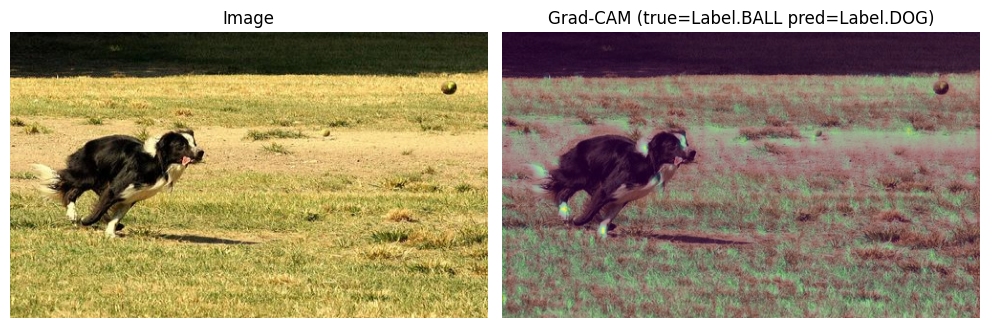


--- Mauvaise prédiction ---
dataset_idx : 109
image      : ../data/final_dataset/new_ball/ball_653/new_ball_653.jpg
vrai label : Label.BALL (0)
prédit     : Label.WATER (3)
caption    : In this idyllic outdoor setting, a black dog paddles through the calm water of a serene lake. As it swims effortlessly, it expertly juggles its catch - a bright yellow tennis ball - with its paws, momentarily pausing in mid-water before continuing on its leisurely journey. The tranquil atmosphere is broken only by the occasional lapping of the water against the shore and the dog's joyful splashing as it plays with its impromptu treasure.


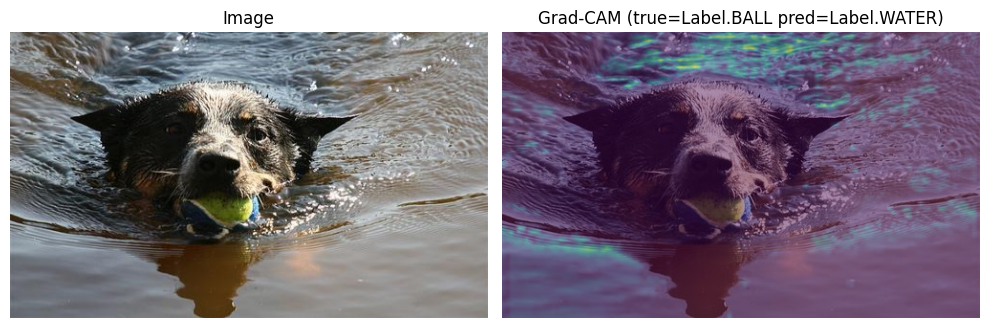


--- Mauvaise prédiction ---
dataset_idx : 421
image      : ../data/final_dataset/new_ball/ball_618/new_ball_618.jpg
vrai label : Label.BALL (0)
prédit     : Label.WATER (3)
caption    : The sun beats down on the pool deck as two friends engage in a spirited game of volleyball, their laughter carrying across the water. The person standing at the net expertly spikes the ball back to her opponent, who attempts to return it with a swift smash. As they leap and dive, their movements are mirrored by the ripples on the surface of the pool below.


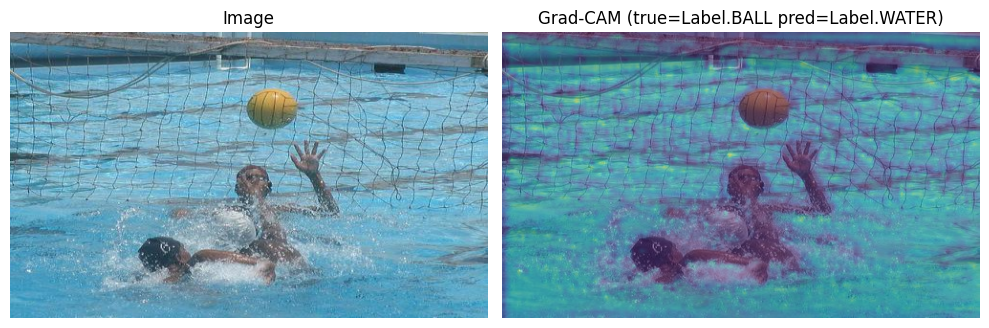


--- Mauvaise prédiction ---
dataset_idx : 219
image      : ../data/final_dataset/new_bike/bike_232/new_bike_232.jpg
vrai label : Label.BIKE (1)
prédit     : Label.WATER (3)
caption    : A group of dirtbikers speed down the muddy track, their tires kicking up clouds of mud as they navigate the treacherous terrain. One rider in particular catches my eye, his bike's suspension compressed as he hits a particularly rough patch and narrowly avoids wiping out. The sound of revving engines and screeching tires fills the air as the riders continue to push themselves to the limit on this demanding course.


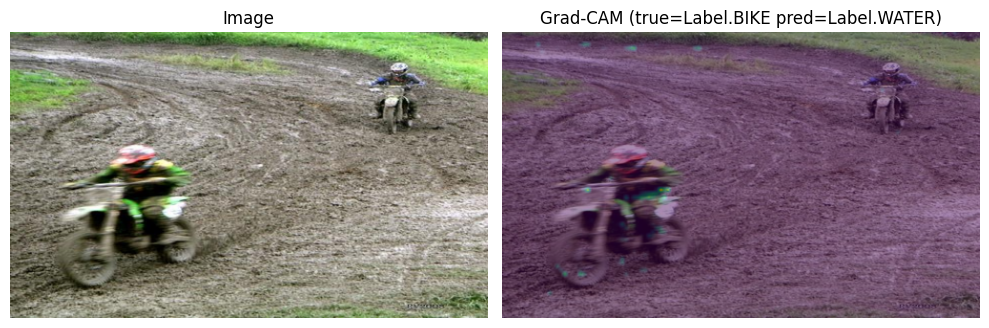

In [37]:
target_layer = model_loaded.features[8]
show_5_mistakes_with_gradcam(
    model=model_loaded,
    loader=train_loader_custom_noaug,
    device=device,
    class_names=class_names,
    target_layer=target_layer,
    dataset=train_dataset_custom_noaug,
    n=5
)

### SECOND TRAINING

Epoch 1/50 [TRAIN]: 100%|██████████| 18/18 [00:04<00:00,  3.81it/s, loss=0.609]



Epoch 1 - Average TRAIN loss: 0.6086


Epoch 1/50 [EVAL]: 100%|██████████| 4/4 [00:00<00:00,  5.13it/s]


Epoch 1 - Average TEST loss: 0.3589

Classification Report:
              precision    recall  f1-score   support

           0      0.829     0.879     0.853        33
           1      0.968     0.968     0.968        31
           2      1.000     0.692     0.818        26
           3      0.833     1.000     0.909        30

    accuracy                          0.892       120
   macro avg      0.907     0.885     0.887       120
weighted avg      0.903     0.892     0.889       120

Nouveau meilleur modèle sauvegardé (test loss: 0.3589)


Epoch 2/50 [TRAIN]: 100%|██████████| 18/18 [00:05<00:00,  3.60it/s, loss=0.528]



Epoch 2 - Average TRAIN loss: 0.5277


Epoch 2/50 [EVAL]: 100%|██████████| 4/4 [00:00<00:00,  4.71it/s]


Epoch 2 - Average TEST loss: 0.2546

Classification Report:
              precision    recall  f1-score   support

           0      0.967     0.879     0.921        33
           1      0.969     1.000     0.984        31
           2      0.923     0.923     0.923        26
           3      0.938     1.000     0.968        30

    accuracy                          0.950       120
   macro avg      0.949     0.950     0.949       120
weighted avg      0.950     0.950     0.949       120

Nouveau meilleur modèle sauvegardé (test loss: 0.2546)


Epoch 3/50 [TRAIN]: 100%|██████████| 18/18 [00:04<00:00,  3.74it/s, loss=0.416]



Epoch 3 - Average TRAIN loss: 0.4157


Epoch 3/50 [EVAL]: 100%|██████████| 4/4 [00:00<00:00,  5.09it/s]


Epoch 3 - Average TEST loss: 0.2593

Classification Report:
              precision    recall  f1-score   support

           0      0.963     0.788     0.867        33
           1      0.967     0.935     0.951        31
           2      0.743     1.000     0.852        26
           3      0.929     0.867     0.897        30

    accuracy                          0.892       120
   macro avg      0.900     0.898     0.892       120
weighted avg      0.908     0.892     0.893       120

Pas d'amélioration (1/5)


Epoch 4/50 [TRAIN]: 100%|██████████| 18/18 [00:05<00:00,  3.40it/s, loss=0.447]



Epoch 4 - Average TRAIN loss: 0.4468


Epoch 4/50 [EVAL]: 100%|██████████| 4/4 [00:00<00:00,  5.27it/s]


Epoch 4 - Average TEST loss: 0.3044

Classification Report:
              precision    recall  f1-score   support

           0      0.933     0.848     0.889        33
           1      0.939     1.000     0.969        31
           2      0.926     0.962     0.943        26
           3      0.933     0.933     0.933        30

    accuracy                          0.933       120
   macro avg      0.933     0.936     0.934       120
weighted avg      0.933     0.933     0.932       120

Pas d'amélioration (2/5)


Epoch 5/50 [TRAIN]: 100%|██████████| 18/18 [00:04<00:00,  3.84it/s, loss=0.391]



Epoch 5 - Average TRAIN loss: 0.3910


Epoch 5/50 [EVAL]: 100%|██████████| 4/4 [00:00<00:00,  4.93it/s]


Epoch 5 - Average TEST loss: 0.3742

Classification Report:
              precision    recall  f1-score   support

           0      0.962     0.758     0.847        33
           1      0.861     1.000     0.925        31
           2      0.839     1.000     0.912        26
           3      0.963     0.867     0.912        30

    accuracy                          0.900       120
   macro avg      0.906     0.906     0.899       120
weighted avg      0.909     0.900     0.898       120

Pas d'amélioration (3/5)


Epoch 6/50 [TRAIN]: 100%|██████████| 18/18 [00:04<00:00,  3.73it/s, loss=0.328]



Epoch 6 - Average TRAIN loss: 0.3276


Epoch 6/50 [EVAL]: 100%|██████████| 4/4 [00:00<00:00,  5.25it/s]


Epoch 6 - Average TEST loss: 0.3463

Classification Report:
              precision    recall  f1-score   support

           0      1.000     0.727     0.842        33
           1      0.912     1.000     0.954        31
           2      0.897     1.000     0.945        26
           3      0.848     0.933     0.889        30

    accuracy                          0.908       120
   macro avg      0.914     0.915     0.908       120
weighted avg      0.917     0.908     0.905       120

Pas d'amélioration (4/5)


Epoch 7/50 [TRAIN]: 100%|██████████| 18/18 [00:04<00:00,  3.84it/s, loss=0.376]



Epoch 7 - Average TRAIN loss: 0.3762


Epoch 7/50 [EVAL]: 100%|██████████| 4/4 [00:00<00:00,  5.22it/s]


Epoch 7 - Average TEST loss: 0.4295

Classification Report:
              precision    recall  f1-score   support

           0      0.885     0.697     0.780        33
           1      0.967     0.935     0.951        31
           2      0.900     0.692     0.783        26
           3      0.682     1.000     0.811        30

    accuracy                          0.833       120
   macro avg      0.858     0.831     0.831       120
weighted avg      0.858     0.833     0.832       120

Pas d'amélioration (5/5)

Early stopping déclenché après 7 époques
Meilleur test loss: 0.2546

Chargement du meilleur modèle (test loss: 0.2546)


Epoch 1/1 [EVAL]: 100%|██████████| 4/4 [00:00<00:00,  5.29it/s]


Best model - TEST loss: 0.2546


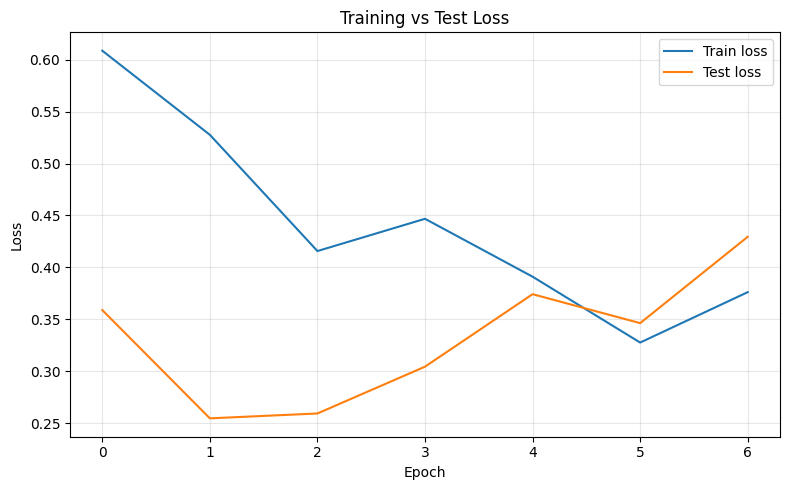

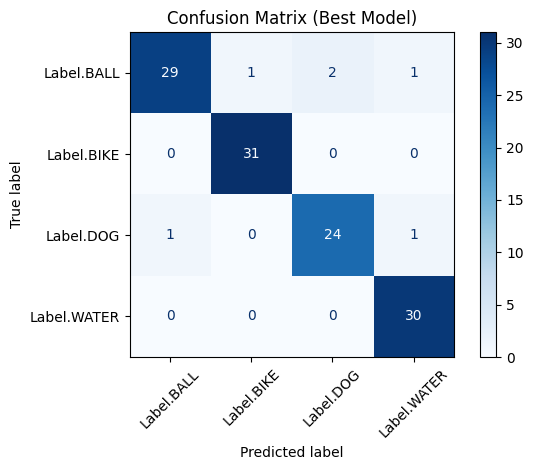

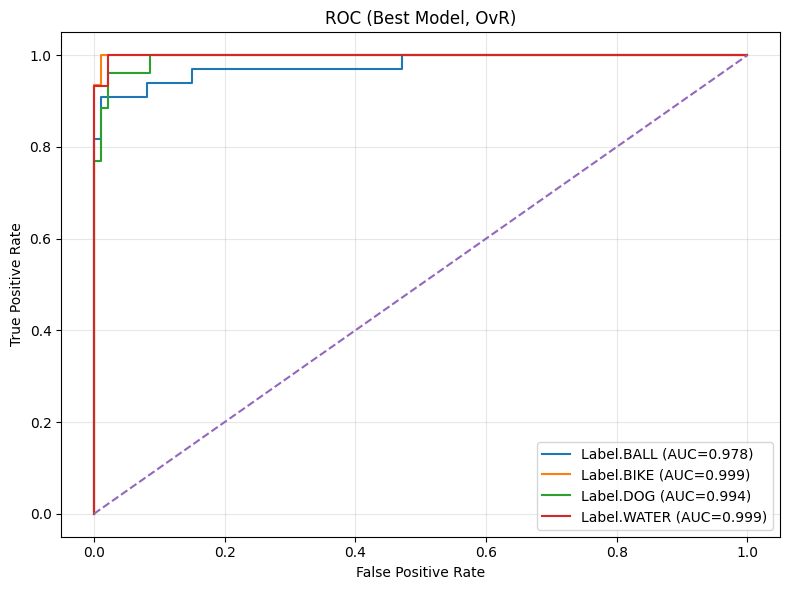

In [42]:
best_model_path = Path("../models/best_model_2.pth")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_loaded = CNNBasic(num_classes=4)
model_loaded = model_loaded.to(device)
model_loaded.load_state_dict(torch.load(best_model_path, map_location=device))

trained_model, history = fit(
    model=model_loaded,
    train_loader=train_loader_custom_noaug,
    test_loader=test_loader_custom_noaug,
    num_classes=4,
    epochs=50,
    lr=1e-3,
    momentum=0.9,
    patience=5,
    models_dir=Path("../models"),
    best_name="best_model_v2_2train.pth",
    criterion=nn.CrossEntropyLoss(),
    class_names=class_names,
)



Epoch 1/1 [EVAL]:   0%|          | 0/4 [00:00<?, ?it/s]

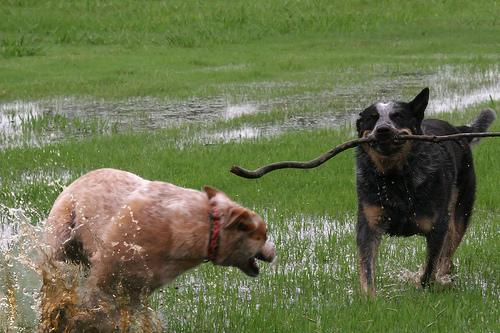


--- Mauvaise prédiction ---
dataset_idx : 9
image      : ../data/final_dataset_noaug/new_water/water_260/new_water_260.jpg
vrai label : Label.WATER (3)
prédit     : Label.DOG (2)
caption    : a boy cleans the bubbles off his face .


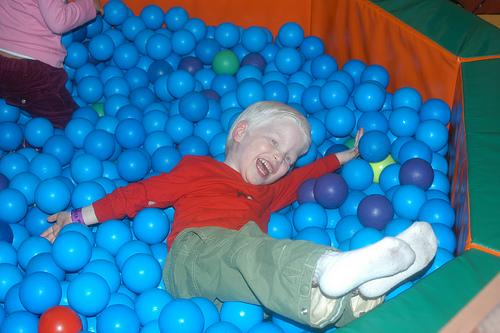

Epoch 1/1 [EVAL]:  25%|██▌       | 1/4 [00:00<00:00,  3.66it/s]


--- Mauvaise prédiction ---
dataset_idx : 27
image      : ../data/final_dataset_noaug/new_ball/ball_094/new_ball_094.jpg
vrai label : Label.BALL (0)
prédit     : Label.WATER (3)
caption    : The girl, who was laughing, carefully tossed the ball to her friend in the pool, while the woman, splashing water everywhere, tried to catch it mid-air. The sun beat down on their faces as they played together, creating a warm and carefree atmosphere. Nearby, other children were swimming laps or floating on inflatable rafts, adding to the lively scene.


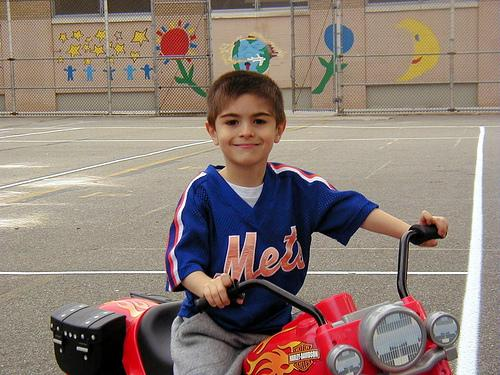


--- Mauvaise prédiction ---
dataset_idx : 34
image      : ../data/final_dataset_noaug/new_bike/bike_248/new_bike_248.jpg
vrai label : Label.BIKE (1)
prédit     : Label.WATER (3)
caption    : A backpacker standing near water at dusk .


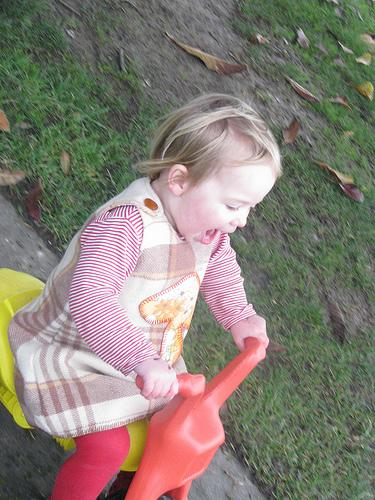


--- Mauvaise prédiction ---
dataset_idx : 41
image      : ../data/final_dataset_noaug/new_bike/bike_376/new_bike_376.jpg
vrai label : Label.BIKE (1)
prédit     : Label.WATER (3)
caption    : A rugged trail winds its way up the hillside, where a lone cyclist pedals steadily on his trusty mountain bike. The rough terrain requires focus and balance as he navigates around loose rocks and uneven ground. In the distance, the landscape unfolds with rolling hills and verdant valleys stretching out towards the horizon.


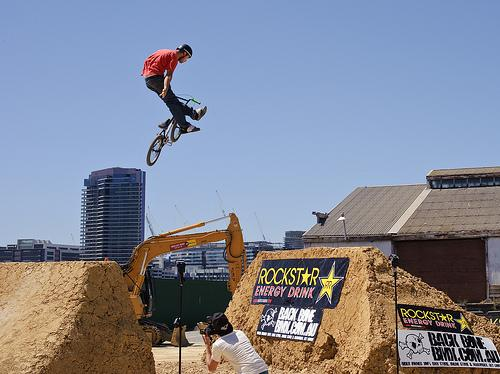

Epoch 1/1 [EVAL]:  50%|█████     | 2/4 [00:00<00:00,  2.97it/s]


--- Mauvaise prédiction ---
dataset_idx : 50
image      : ../data/final_dataset_noaug/new_bike/bike_186/new_bike_186.jpg
vrai label : Label.BIKE (1)
prédit     : Label.WATER (3)
caption    : A group of people stand in the sand looking out at the water .


Epoch 1/1 [EVAL]: 100%|██████████| 4/4 [00:01<00:00,  3.74it/s]


Best model - TEST loss: 0.3426
Accuracy : 0.9083333611488342



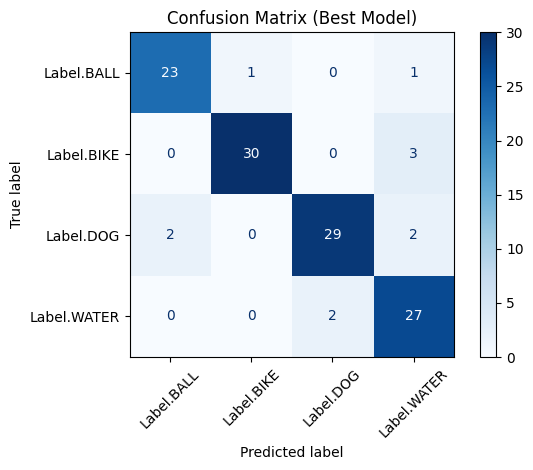

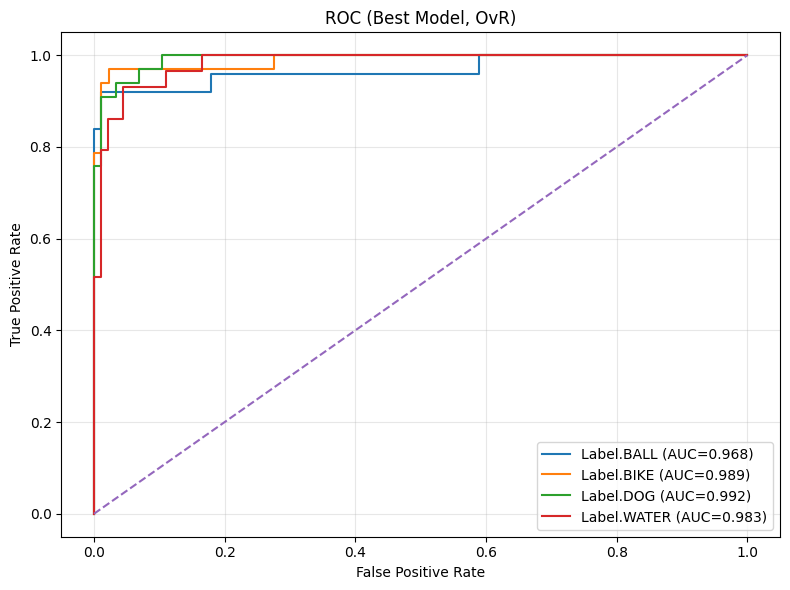

In [44]:
best_model_path = Path("../models/best_model_v2_2train.pth")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model_loaded = CNNBasic(num_classes=4)
model_loaded = model_loaded.to(device)
model_loaded.load_state_dict(torch.load(best_model_path, map_location=device))
criterion = nn.CrossEntropyLoss()

final_test_loss, y_true, y_pred, y_prob, acc = evaluate(
    model_loaded, val_loader_custom_noaug, criterion, device, class_names=class_names, epoch=0, epochs=1, num_classes=4,dataset=val_dataset_custom_noaug
)
print(f"Best model - TEST loss: {final_test_loss:.4f}")
print(f"Accuracy : {acc}\n")
plot_confusion_matrix(y_true, y_pred, class_names=class_names, title="Confusion Matrix (Best Model)")
plot_multiclass_roc(y_true, y_prob, num_classes=4, class_names=class_names, title="ROC (Best Model, OvR)")


--- Mauvaise prédiction ---
dataset_idx : 9
image      : ../data/final_dataset_noaug/new_water/water_260/new_water_260.jpg
vrai label : Label.WATER (3)
prédit     : Label.DOG (2)
caption    : a boy cleans the bubbles off his face .


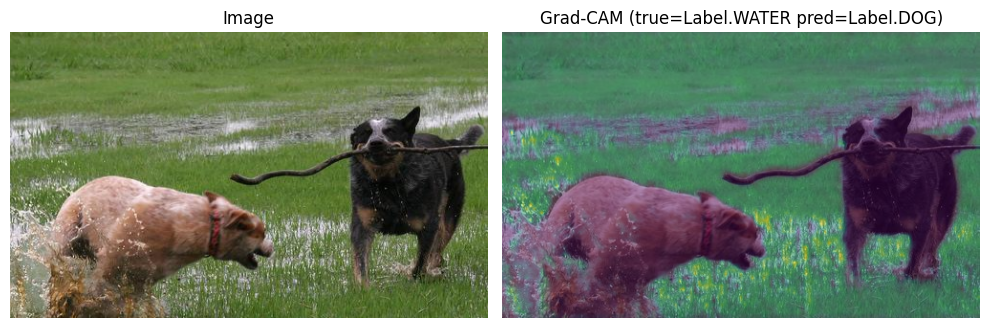


--- Mauvaise prédiction ---
dataset_idx : 27
image      : ../data/final_dataset_noaug/new_ball/ball_094/new_ball_094.jpg
vrai label : Label.BALL (0)
prédit     : Label.WATER (3)
caption    : The girl, who was laughing, carefully tossed the ball to her friend in the pool, while the woman, splashing water everywhere, tried to catch it mid-air. The sun beat down on their faces as they played together, creating a warm and carefree atmosphere. Nearby, other children were swimming laps or floating on inflatable rafts, adding to the lively scene.


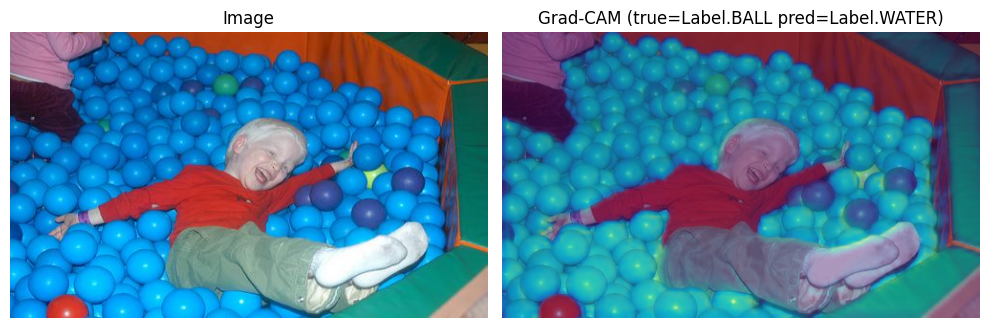


--- Mauvaise prédiction ---
dataset_idx : 34
image      : ../data/final_dataset_noaug/new_bike/bike_248/new_bike_248.jpg
vrai label : Label.BIKE (1)
prédit     : Label.WATER (3)
caption    : A backpacker standing near water at dusk .


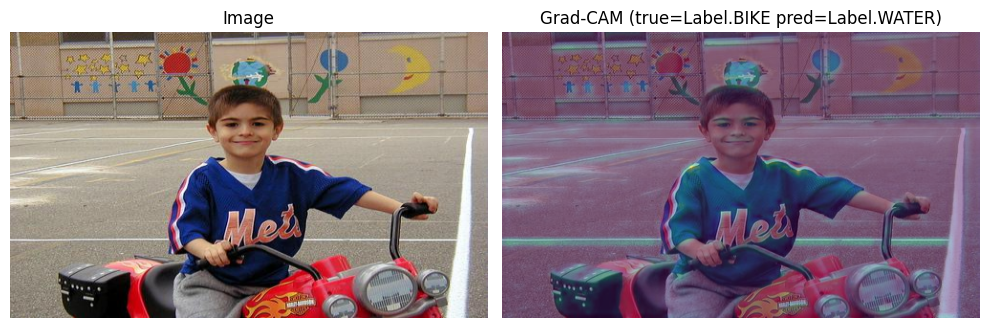


--- Mauvaise prédiction ---
dataset_idx : 41
image      : ../data/final_dataset_noaug/new_bike/bike_376/new_bike_376.jpg
vrai label : Label.BIKE (1)
prédit     : Label.WATER (3)
caption    : A rugged trail winds its way up the hillside, where a lone cyclist pedals steadily on his trusty mountain bike. The rough terrain requires focus and balance as he navigates around loose rocks and uneven ground. In the distance, the landscape unfolds with rolling hills and verdant valleys stretching out towards the horizon.


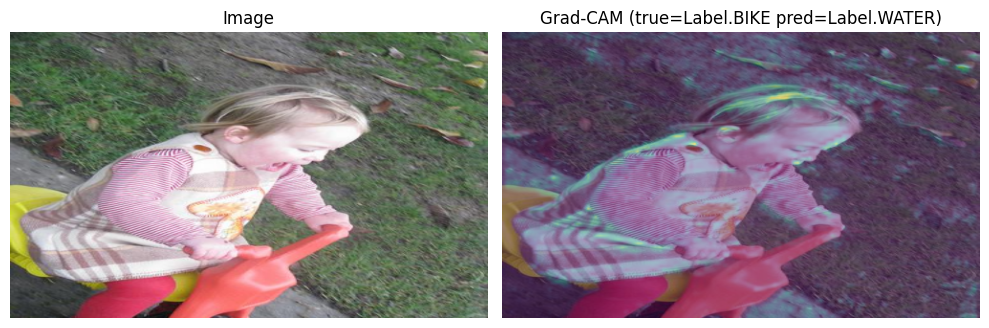


--- Mauvaise prédiction ---
dataset_idx : 50
image      : ../data/final_dataset_noaug/new_bike/bike_186/new_bike_186.jpg
vrai label : Label.BIKE (1)
prédit     : Label.WATER (3)
caption    : A group of people stand in the sand looking out at the water .


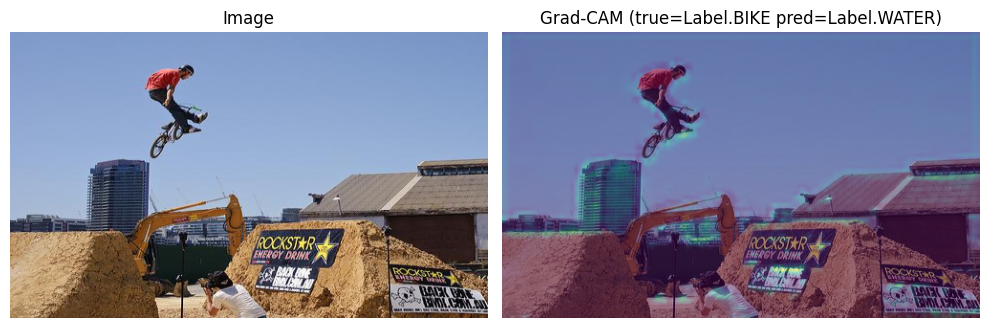

In [46]:
target_layer = model_loaded.features[8]
show_5_mistakes_with_gradcam(
    model=model_loaded,
    loader=val_loader_custom_noaug,
    device=device,
    class_names=class_names,
    target_layer=target_layer,
    dataset=val_dataset_custom_noaug,
    n=5
)

### RESNET TRAINING

In [80]:
from torchvision.models import resnet18, ResNet18_Weights
num_classes = 4

model_resnet = resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)
model_resnet.fc = nn.Linear(model_resnet.fc.in_features, num_classes)
model_resnet.avgpool = nn.AdaptiveAvgPool2d((1, 1)) 
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model_resnet = model_resnet.to(device)
optimizer = optim.Adam(model_resnet.parameters(), lr=1e-4, weight_decay=1e-5)


criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model_resnet.parameters(), lr=1e-4, weight_decay=1e-5)

best_val_loss = float("inf")
best_epoch = -1
save_path = "best-model-resnet.pth"

for epoch in range(11):
    # ===== TRAIN =====
    model_resnet.train()
    running_loss = 0.0

    for idx, inputs, labels, caption in tqdm(train_loader_resnet, desc=f"TRAIN {epoch+1}"):
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        logits = model_resnet(inputs)
        loss = criterion(logits, labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    train_loss = running_loss / len(train_loader_resnet)
    print(f"Epoch {epoch+1}: Train loss = {train_loss:.4f}")

    # ===== VALIDATION =====
    model_resnet.eval()
    val_loss = 0.0
    correct, total = 0, 0

    with torch.no_grad():
        for idx, inputs, labels, caption in tqdm(val_loader_resnet, desc=f"VAL {epoch+1}"):
            inputs, labels = inputs.to(device), labels.to(device)

            logits = model_resnet(inputs)
            loss = criterion(logits, labels)

            val_loss += loss.item()
            preds = logits.argmax(dim=1)
            correct += (preds == labels).sum().item()
            total += labels.size(0)

    val_loss /= len(val_loader_resnet)
    val_acc = correct / total

    print(f"Epoch {epoch+1}: Val loss = {val_loss:.4f} | Val acc = {val_acc:.4f}")

    # ===== SAVE BEST =====
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        best_epoch = epoch + 1

        torch.save({
            "epoch": best_epoch,
            "model_state_dict": model_resnet.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "val_loss": best_val_loss,
        }, save_path)

        print(f"✅ Best model saved at epoch {best_epoch} with val_loss={best_val_loss:.4f}")

print(f"\n🏁 Training finished. Best epoch = {best_epoch}, best val_loss = {best_val_loss:.4f}")


TRAIN 1: 100%|██████████| 92/92 [00:19<00:00,  4.75it/s]


Epoch 1: Train loss = 0.6737


VAL 1: 100%|██████████| 20/20 [00:02<00:00,  7.17it/s]


Epoch 1: Val loss = 0.4145 | Val acc = 0.8492
✅ Best model saved at epoch 1 with val_loss=0.4145


TRAIN 2: 100%|██████████| 92/92 [00:18<00:00,  5.05it/s]


Epoch 2: Train loss = 0.1519


VAL 2: 100%|██████████| 20/20 [00:02<00:00,  7.52it/s]


Epoch 2: Val loss = 0.4211 | Val acc = 0.8714


TRAIN 3: 100%|██████████| 92/92 [00:17<00:00,  5.12it/s]


Epoch 3: Train loss = 0.0516


VAL 3:  50%|█████     | 10/20 [00:01<00:01,  7.59it/s]

VAL 3: 100%|██████████| 20/20 [00:02<00:00,  6.77it/s]


Epoch 3: Val loss = 0.3041 | Val acc = 0.8905
✅ Best model saved at epoch 3 with val_loss=0.3041


TRAIN 4: 100%|██████████| 92/92 [00:18<00:00,  4.94it/s]


Epoch 4: Train loss = 0.0319


VAL 4: 100%|██████████| 20/20 [00:03<00:00,  6.30it/s]


Epoch 4: Val loss = 0.3135 | Val acc = 0.9000


TRAIN 5: 100%|██████████| 92/92 [00:18<00:00,  4.94it/s]


Epoch 5: Train loss = 0.0254


VAL 5: 100%|██████████| 20/20 [00:02<00:00,  7.61it/s]


Epoch 5: Val loss = 0.3473 | Val acc = 0.9016


TRAIN 6: 100%|██████████| 92/92 [00:18<00:00,  5.03it/s]


Epoch 6: Train loss = 0.0244


VAL 6: 100%|██████████| 20/20 [00:02<00:00,  7.25it/s]


Epoch 6: Val loss = 0.4027 | Val acc = 0.8810


TRAIN 7: 100%|██████████| 92/92 [00:18<00:00,  4.98it/s]


Epoch 7: Train loss = 0.0200


VAL 7: 100%|██████████| 20/20 [00:02<00:00,  7.41it/s]


Epoch 7: Val loss = 0.3285 | Val acc = 0.9048


TRAIN 8: 100%|██████████| 92/92 [00:18<00:00,  5.08it/s]


Epoch 8: Train loss = 0.0171


VAL 8: 100%|██████████| 20/20 [00:03<00:00,  6.53it/s]


Epoch 8: Val loss = 0.3361 | Val acc = 0.9016


TRAIN 9: 100%|██████████| 92/92 [00:17<00:00,  5.14it/s]


Epoch 9: Train loss = 0.0132


VAL 9: 100%|██████████| 20/20 [00:02<00:00,  7.64it/s]


Epoch 9: Val loss = 0.3591 | Val acc = 0.8968


TRAIN 10: 100%|██████████| 92/92 [00:18<00:00,  5.09it/s]


Epoch 10: Train loss = 0.0120


VAL 10: 100%|██████████| 20/20 [00:02<00:00,  7.48it/s]


Epoch 10: Val loss = 0.3792 | Val acc = 0.8952


TRAIN 11: 100%|██████████| 92/92 [00:18<00:00,  4.99it/s]


Epoch 11: Train loss = 0.0114


VAL 11: 100%|██████████| 20/20 [00:02<00:00,  7.50it/s]

Epoch 11: Val loss = 0.3735 | Val acc = 0.8968

🏁 Training finished. Best epoch = 3, best val_loss = 0.3041


Epoch 1/1 [EVAL]: 100%|██████████| 7/7 [00:01<00:00,  4.64it/s]


Best model - TEST loss: 0.1597
Accuracy : 0.971428632736206



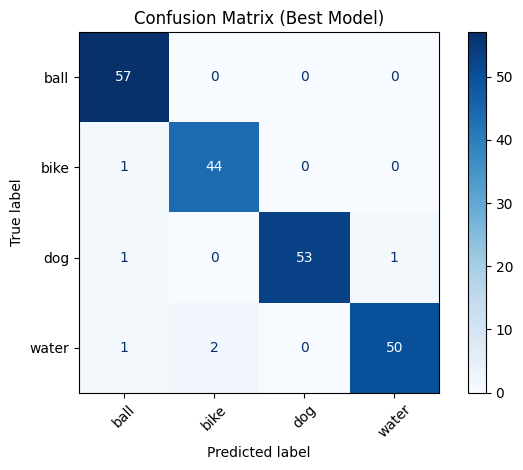

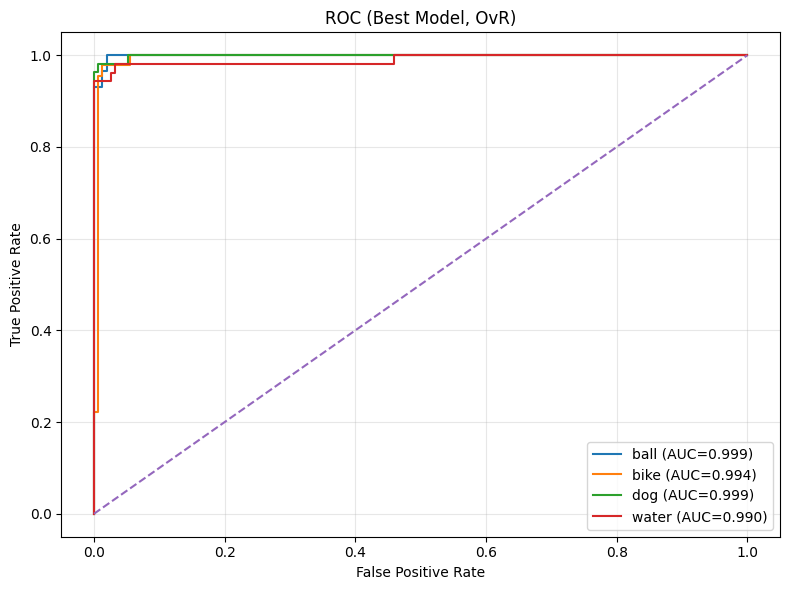

In [92]:
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc
final_test_loss, y_true, y_pred, y_prob, acc = evaluate(
    model_resnet, test_loader_resnet_noaug, criterion, device, epoch=0, epochs=1, num_classes=num_classes
)
print(f"Best model - TEST loss: {final_test_loss:.4f}")
print(f"Accuracy : {acc}\n")
plot_confusion_matrix(y_true, y_pred, class_names=class_names, title="Confusion Matrix (Best Model)")
plot_multiclass_roc(y_true, y_prob, num_classes=4, class_names=class_names, title="ROC (Best Model, OvR)")

In [ ]:
from torchvision.models import resnet18, ResNet18_Weights
num_classes = 4

model_resnet_ee = ResNet18EarlyExit()
model_resnet_ee.avgpool = nn.AdaptiveAvgPool2d((1, 1)) 
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model_resnet_ee = model_resnet_ee.to(device)
optimizer = optim.Adam(model_resnet_ee.parameters(), lr=1e-4, weight_decay=1e-5)


criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model_resnet_ee.parameters(), lr=1e-4, weight_decay=1e-5)

for epoch in range(5):
    model_resnet_ee.train()
    running_loss = 0.0
    for idx, inputs, labels, caption in tqdm(train_loader_resnet, desc=f"TRAIN {epoch+1}"):
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        output = model_resnet_ee(inputs)

        if isinstance(output, tuple):
            logits = output[0]
        else:
            logits = output

        loss = criterion(logits, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f"Epoch {epoch+1}: Train loss = {running_loss/len(train_loader_resnet):.4f}")


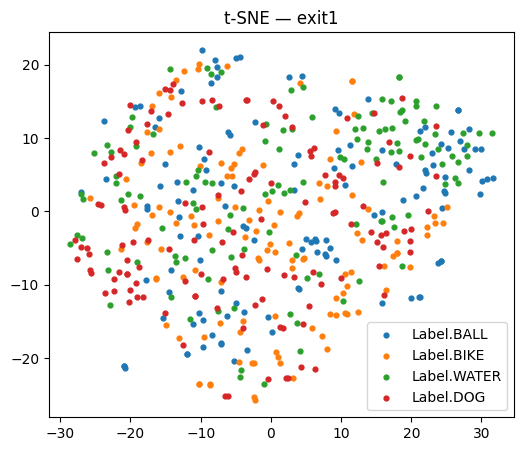

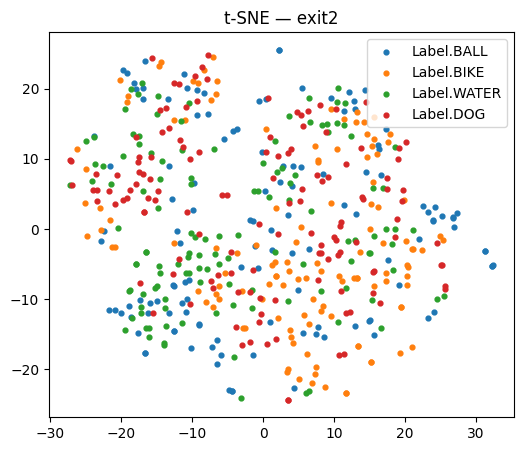

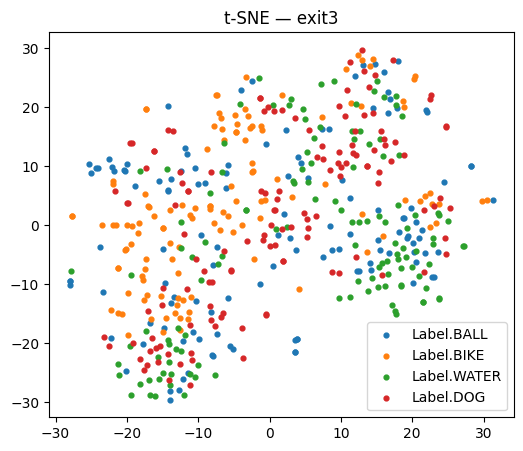

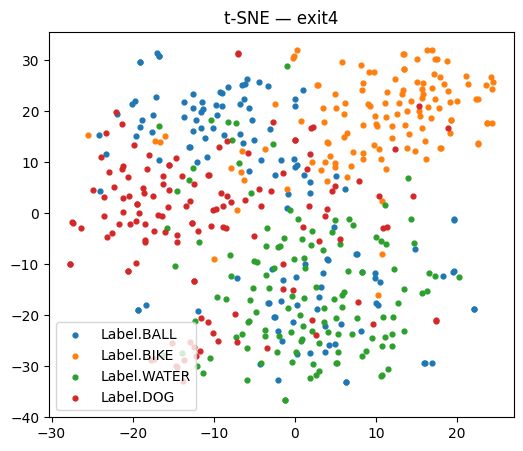

In [63]:
model_resnet_custom = ResNet18EarlyExit()
model_resnet_custom = model_resnet_custom.to(device)
plot_tsne(model_resnet_custom, val_loader_resnet, class_names)


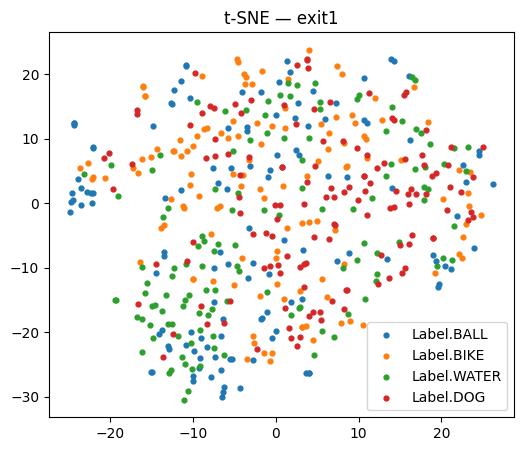

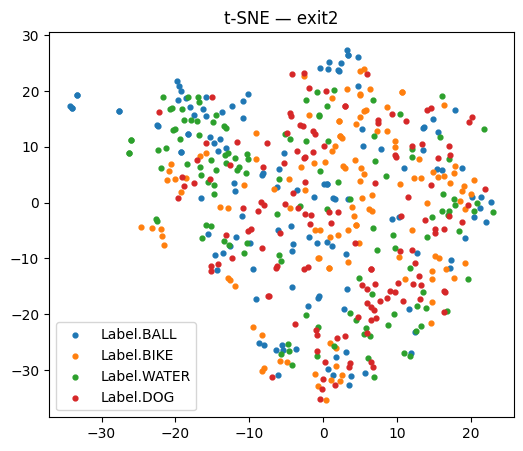

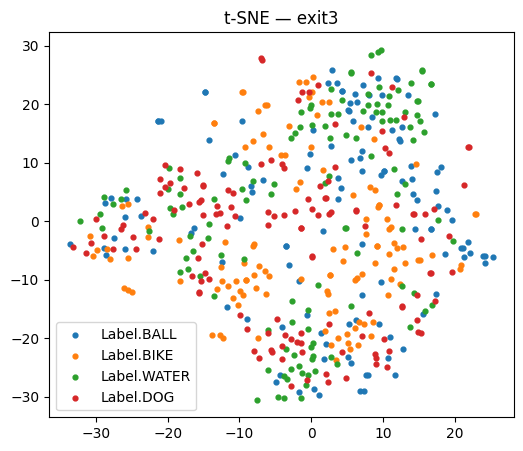

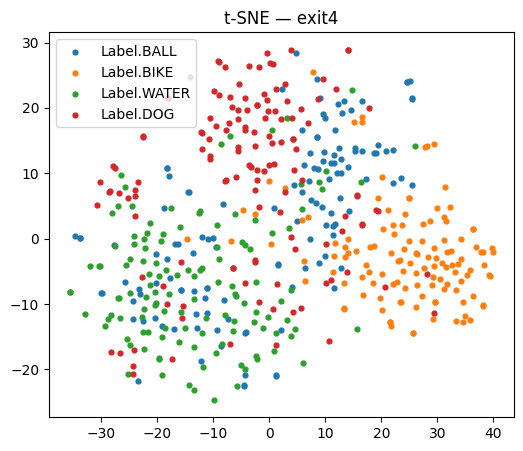

In [ ]:
model_resnet_ee = ResNet18EarlyExit()
model_resnet_ee = model_resnet_custom.to(device)
plot_tsne(model_resnet_ee, val_loader_resnet, class_names)


In [77]:
import torch.optim as optim

def configure_finetuning(
    model,
    mode: str,
    lr_backbone=1e-4,
    lr_head=1e-3,
    weight_decay=1e-5,
):
    """
    Configure le fine-tuning d'un ResNet (ou modèle similaire)

    mode:
        - "freeze_all"
        - "freeze_until_l3"
        - "unfreeze_all"
        - "freeze_semantic
    """

    # 1️⃣ Tout geler par défaut
    for p in model.parameters():
        p.requires_grad = False

    params = []

    # 2️⃣ Configuration par mode
    if mode == "freeze_all":
        # uniquement la tête
        for p in model.fc.parameters():
            p.requires_grad = True

        params = [
            {"params": model.fc.parameters(), "lr": lr_head}
        ]

    elif mode == "freeze_until_l3":
        # défreeze layer4 + fc
        for p in model.layer4.parameters():
            p.requires_grad = True
        for p in model.fc.parameters():
            p.requires_grad = True

        params = [
            {"params": model.layer4.parameters(), "lr": lr_backbone},
            {"params": model.fc.parameters(),     "lr": lr_head},
        ]
    elif mode == "freeze_semantic":
        # Tout entraînable
        for p in model.parameters():
            p.requires_grad = True

        # Geler layer4
        for p in model.layer4.parameters():
            p.requires_grad = False

        # Optimizer: backbone (trainable) + head
        backbone_params = []
        head_params = []

        for name, p in model.named_parameters():
            if not p.requires_grad:
                continue
            if name.startswith("fc."):
                head_params.append(p)
            else:
                backbone_params.append(p)

        params = [
            {"params": backbone_params, "lr": lr_backbone},
            {"params": head_params,     "lr": lr_head},
        ]



    elif mode == "unfreeze_all":
        # tout défreeze
        for p in model.parameters():
            p.requires_grad = True

        params = [
            {"params": model.parameters(), "lr": lr_backbone}
        ]

    else:
        raise ValueError(f"Mode inconnu : {mode}")

    # 3️⃣ Optimizer
    optimizer = optim.Adam(params, weight_decay=weight_decay)

    return optimizer


optimizer = configure_finetuning(
    model_resnet,
    mode="freeze_until_l3"
)


In [66]:
def train_one_experiment(
    model,
    train_loader,
    optimizer,
    criterion,
    device,
    epochs=5
):
    model.to(device)

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0

        for idx, inputs, labels, caption in tqdm(
            train_loader,
            desc=f"TRAIN epoch {epoch+1}"
        ):
            inputs = inputs.to(device)
            labels = labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)

            logits = outputs[0] if isinstance(outputs, tuple) else outputs
            loss = criterion(logits, labels)

            loss.backward()
            optimizer.step()

            running_loss += loss.item()

        print(
            f"Epoch {epoch+1}: "
            f"Train loss = {running_loss / len(train_loader):.4f}"
        )


In [74]:
@torch.no_grad()
def extract_resnet_layer_embeddings(model, loader, device, max_batches=None):
    """
    Retourne:
      feats: dict { "layer1": [N, C1], "layer2": [N, C2], "layer3": [N, C3], "layer4": [N, C4] }
      labels: [N]
    """
    model.eval()
    feats = {"layer1": [], "layer2": [], "layer3": [], "layer4": []}
    all_labels = []

    for b, batch in enumerate(loader):
        if max_batches is not None and b >= max_batches:
            break

        # ton loader renvoie: idx, inputs, labels, caption
        _, x, y, _ = batch
        x = x.to(device)
        y = y.to(device)

        # forward "manuel" (on ne passe pas par model(x) pour éviter la fc)
        x = model.conv1(x)
        x = model.bn1(x)
        x = model.relu(x)
        x = model.maxpool(x)

        x1 = model.layer1(x)
        x2 = model.layer2(x1)
        x3 = model.layer3(x2)
        x4 = model.layer4(x3)

        # GAP -> [B, C]
        f1 = F.adaptive_avg_pool2d(x1, (1, 1)).flatten(1)
        f2 = F.adaptive_avg_pool2d(x2, (1, 1)).flatten(1)
        f3 = F.adaptive_avg_pool2d(x3, (1, 1)).flatten(1)
        f4 = F.adaptive_avg_pool2d(x4, (1, 1)).flatten(1)

        feats["layer1"].append(f1.cpu())
        feats["layer2"].append(f2.cpu())
        feats["layer3"].append(f3.cpu())
        feats["layer4"].append(f4.cpu())
        all_labels.append(y.cpu())

    for k in feats:
        feats[k] = torch.cat(feats[k], dim=0).numpy()
    all_labels = torch.cat(all_labels, dim=0).numpy()

    return feats, all_labels
def plot_tsne_one(feat_2d, labels, class_names, title):
    plt.figure(figsize=(6, 5))
    for i, name in enumerate(class_names):
        mask = labels == i
        plt.scatter(feat_2d[mask, 0], feat_2d[mask, 1], s=10, label=name, alpha=0.7)
    plt.title(title)
    plt.legend(markerscale=2, fontsize=8)
    plt.tight_layout()
    plt.show()

def plot_tsne_layers(model, loader, device, class_names, mode_name="", max_batches=None,
                     perplexity=30, n_iter=1000, random_state=0):
    feats, labels = extract_resnet_layer_embeddings(model, loader, device, max_batches=max_batches)

    for layer_name in ["layer1", "layer2", "layer3", "layer4"]:
        X = feats[layer_name]

        # t-SNE
        tsne = TSNE(
            n_components=2,
            perplexity=perplexity,
            init="pca",
            learning_rate="auto",
            random_state=random_state
        )
        X2 = tsne.fit_transform(X)

        plot_tsne_one(
            X2, labels, class_names,
            title=f"t-SNE {mode_name} — {layer_name} (N={len(labels)})"
        )


🚀 Training mode: freeze_all


TRAIN epoch 1:  38%|███▊      | 35/92 [00:04<00:07,  7.36it/s]

TRAIN epoch 1: 100%|██████████| 92/92 [00:13<00:00,  6.80it/s]


Epoch 1: Train loss = 1.0289


TRAIN epoch 2: 100%|██████████| 92/92 [00:13<00:00,  6.88it/s]


Epoch 2: Train loss = 0.7483


TRAIN epoch 3: 100%|██████████| 92/92 [00:13<00:00,  6.92it/s]


Epoch 3: Train loss = 0.6861


TRAIN epoch 4: 100%|██████████| 92/92 [00:12<00:00,  7.17it/s]


Epoch 4: Train loss = 0.6386


TRAIN epoch 5: 100%|██████████| 92/92 [00:13<00:00,  7.00it/s]


Epoch 5: Train loss = 0.6276


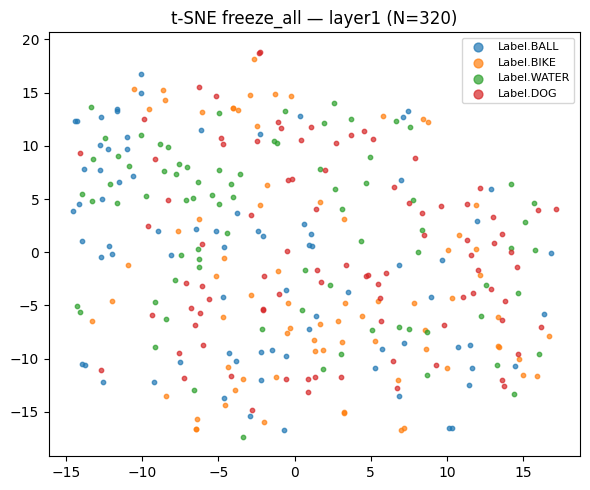

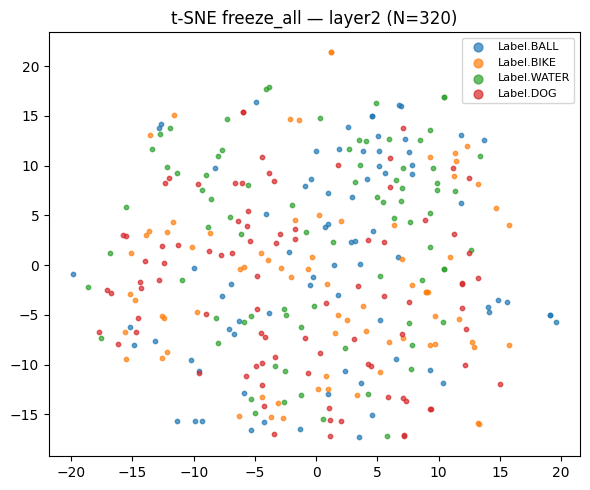

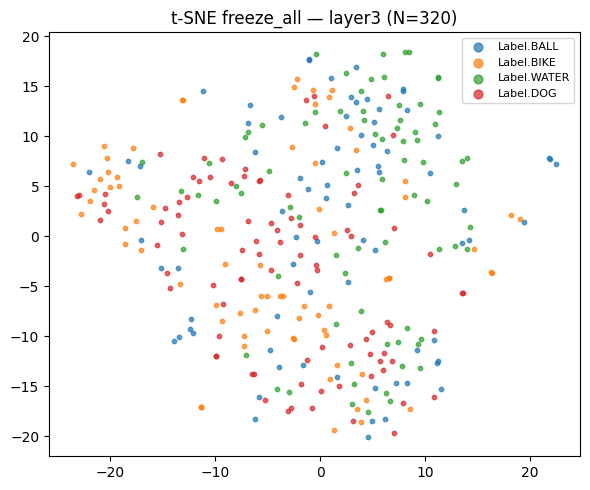

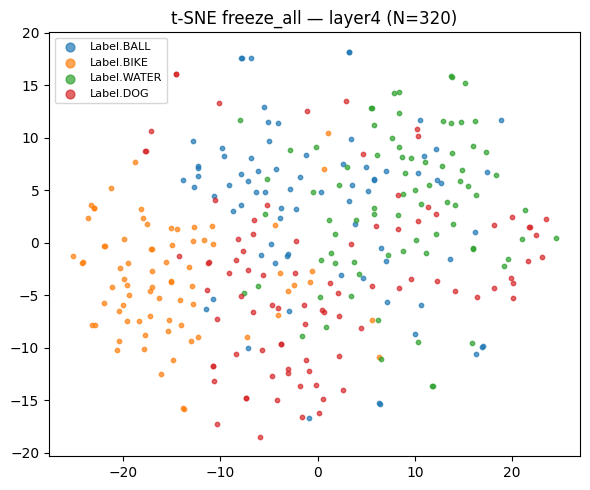


🚀 Training mode: freeze_until_l3


TRAIN epoch 1: 100%|██████████| 92/92 [00:13<00:00,  6.63it/s]


Epoch 1: Train loss = 0.6762


TRAIN epoch 2: 100%|██████████| 92/92 [00:14<00:00,  6.53it/s]


Epoch 2: Train loss = 0.1906


TRAIN epoch 3: 100%|██████████| 92/92 [00:13<00:00,  6.64it/s]


Epoch 3: Train loss = 0.0652


TRAIN epoch 4: 100%|██████████| 92/92 [00:14<00:00,  6.50it/s]


Epoch 4: Train loss = 0.0451


TRAIN epoch 5: 100%|██████████| 92/92 [00:13<00:00,  6.63it/s]


Epoch 5: Train loss = 0.0319


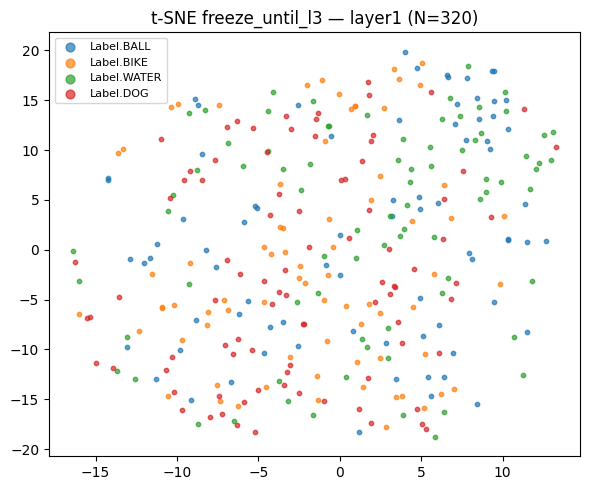

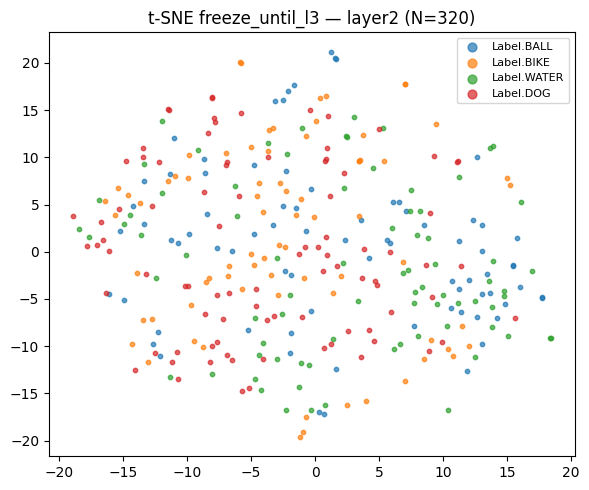

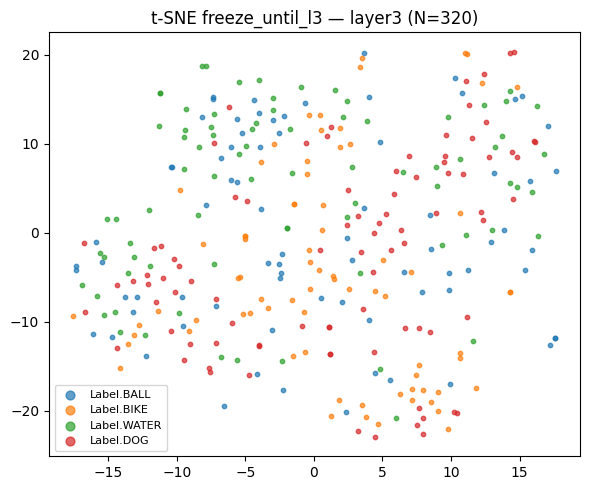

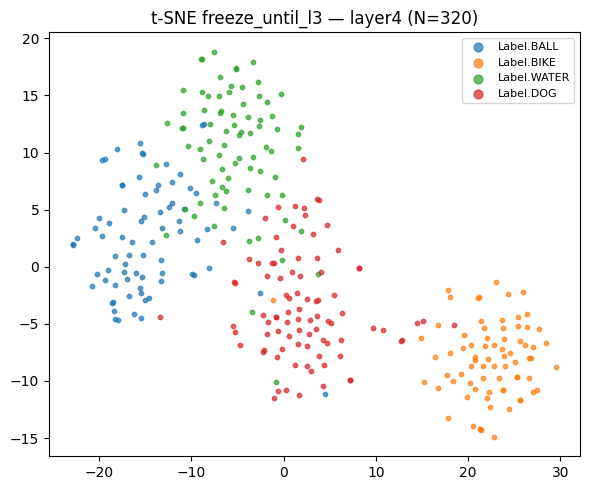


🚀 Training mode: freeze_semantic


AttributeError: 'ResNet' object has no attribute 'stem'

In [ ]:
modes = [
    "freeze_all",
    "freeze_until_l3",
    "freeze_semantic",
    "unfreeze_all",
]

for mode in modes:
    print("\n" + "=" * 50)
    print(f"Training mode: {mode}")
    print("=" * 50)

    model_resnet_freeze = resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)
    model_resnet_freeze.fc = nn.Linear(model_resnet_freeze.fc.in_features, num_classes)

    optimizer = configure_finetuning(model_resnet_freeze, mode=mode)

    train_one_experiment(
        model=model_resnet_freeze,
        train_loader=train_loader_resnet,
        optimizer=optimizer,
        criterion=criterion,
        device=device,
        epochs=5
    )

    # t-SNE pour layer1..layer4 (sur val)
    plot_tsne_layers(
        model=model_resnet_freeze,
        loader=val_loader_resnet,
        device=device,
        class_names=class_names,
        mode_name=mode,
        max_batches=10,        # ajuste selon taille dataset/temps
        perplexity=30,
        random_state=11
    )



🚀 Training mode: freeze_semantic


TRAIN epoch 1: 100%|██████████| 92/92 [00:17<00:00,  5.18it/s]


Epoch 1: Train loss = 0.8854


TRAIN epoch 2: 100%|██████████| 92/92 [00:17<00:00,  5.31it/s]


Epoch 2: Train loss = 0.3869


TRAIN epoch 3: 100%|██████████| 92/92 [00:17<00:00,  5.34it/s]


Epoch 3: Train loss = 0.1721


TRAIN epoch 4: 100%|██████████| 92/92 [00:17<00:00,  5.29it/s]


Epoch 4: Train loss = 0.0748


TRAIN epoch 5: 100%|██████████| 92/92 [00:17<00:00,  5.32it/s]


Epoch 5: Train loss = 0.0462


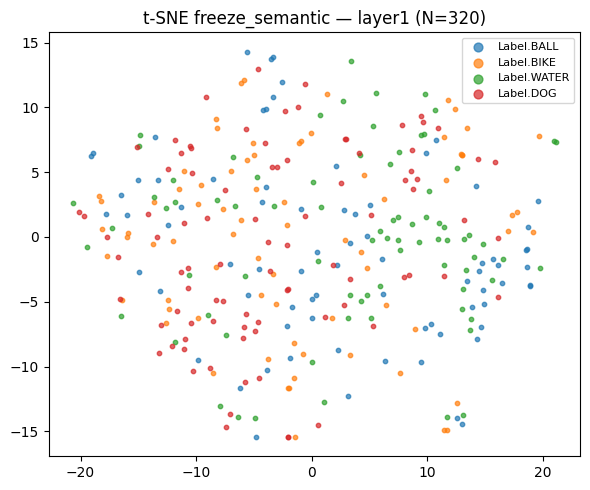

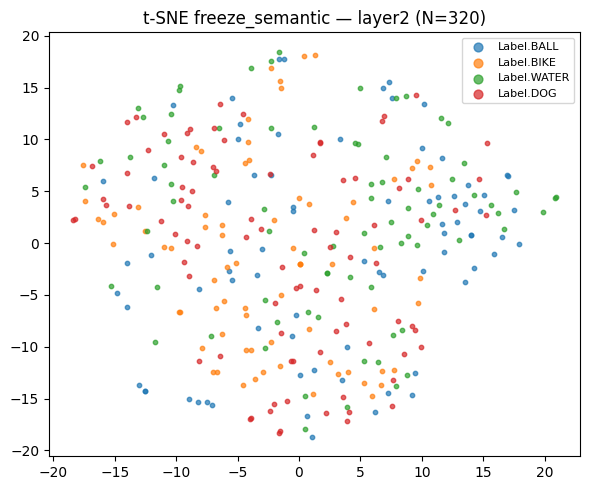

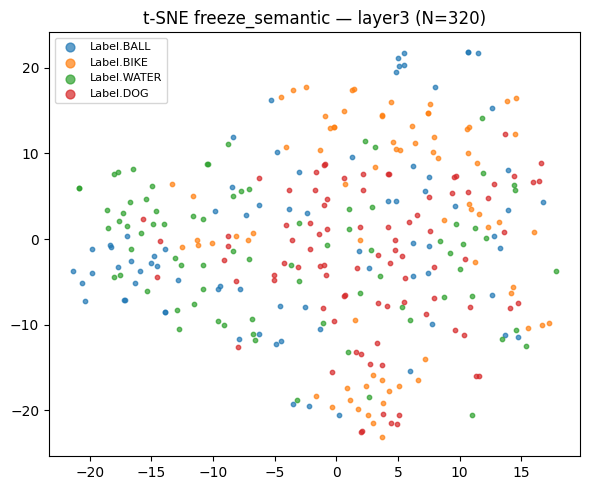

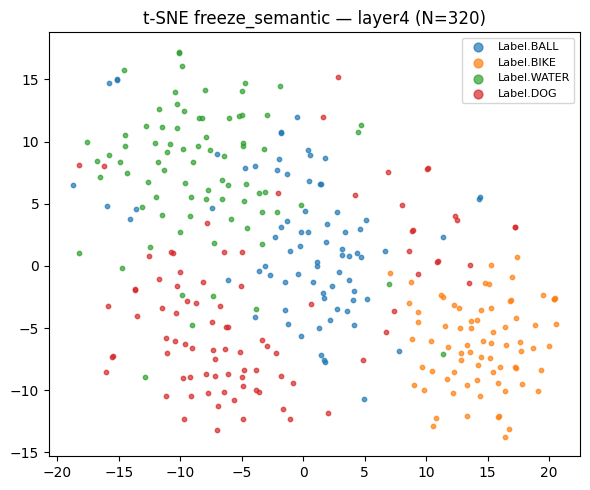


🚀 Training mode: unfreeze_all


TRAIN epoch 1: 100%|██████████| 92/92 [00:18<00:00,  5.07it/s]


Epoch 1: Train loss = 0.6773


TRAIN epoch 2: 100%|██████████| 92/92 [00:18<00:00,  5.06it/s]


Epoch 2: Train loss = 0.1555


TRAIN epoch 3: 100%|██████████| 92/92 [00:18<00:00,  4.97it/s]


Epoch 3: Train loss = 0.0569


TRAIN epoch 4: 100%|██████████| 92/92 [00:18<00:00,  5.06it/s]


Epoch 4: Train loss = 0.0335


TRAIN epoch 5: 100%|██████████| 92/92 [00:18<00:00,  5.05it/s]


Epoch 5: Train loss = 0.0261


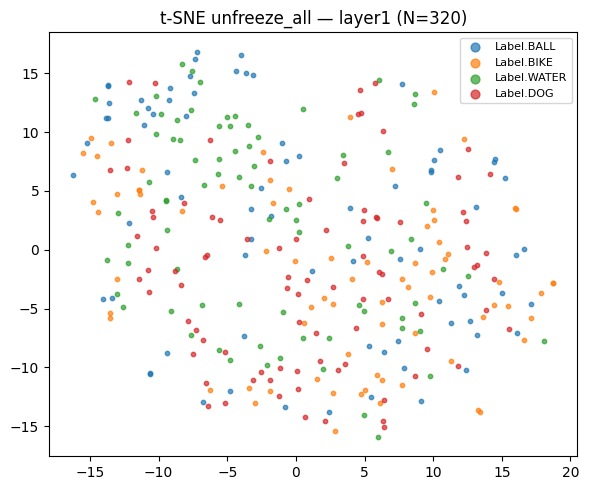

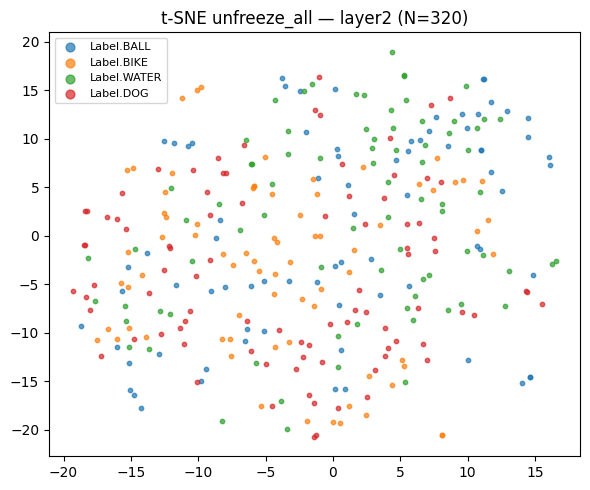

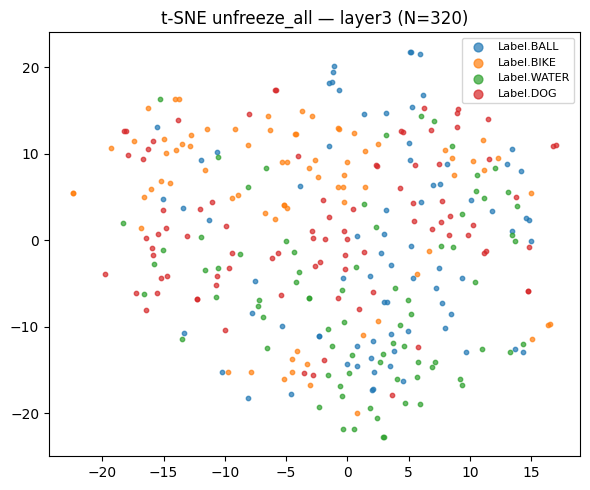

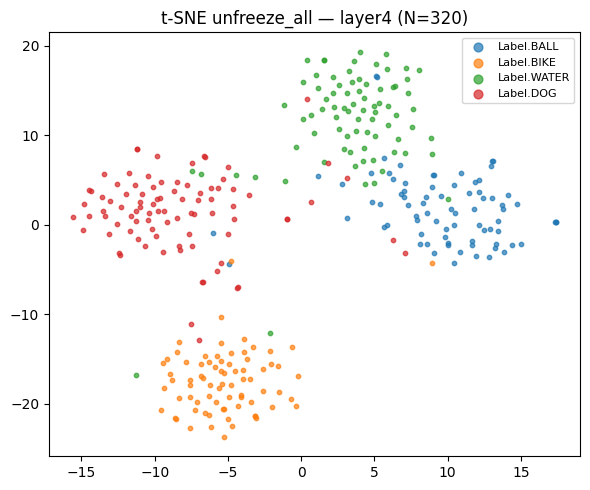

In [78]:
modes = [

    "freeze_semantic",
    "unfreeze_all",
]

for mode in modes:
    print("\n" + "=" * 50)
    print(f"🚀 Training mode: {mode}")
    print("=" * 50)

    model_resnet_freeze = resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)
    model_resnet_freeze.fc = nn.Linear(model_resnet_freeze.fc.in_features, num_classes)

    optimizer = configure_finetuning(model_resnet_freeze, mode=mode)

    train_one_experiment(
        model=model_resnet_freeze,
        train_loader=train_loader_resnet,
        optimizer=optimizer,
        criterion=criterion,
        device=device,
        epochs=5
    )

    # t-SNE pour layer1..layer4 (sur val)
    plot_tsne_layers(
        model=model_resnet_freeze,
        loader=val_loader_resnet,
        device=device,
        class_names=class_names,
        mode_name=mode,
        max_batches=10,        # ajuste selon taille dataset/temps
        perplexity=30,
        random_state=11
    )


In [93]:
def make_class_names_resnet(dataset):
    # dataset.class_to_idx: {label_str: idx}
    idx_to_class = {v: k for k, v in dataset.class_to_idx.items()}
    print(idx_to_class)
    return [idx_to_class[i] for i in range(len(idx_to_class))]


class_name_resnet = make_class_names_resnet(train_dataset_resnet_noaug)
class_names






{0: 'Label.BALL', 1: 'Label.BIKE', 2: 'Label.DOG', 3: 'Label.WATER'}


['Label.BALL', 'Label.BIKE', 'Label.WATER', 'Label.DOG']


🚀 Training mode: freeze_all


TRAIN epoch 1: 100%|██████████| 92/92 [00:12<00:00,  7.37it/s]


Epoch 1: Train loss = 1.0225


TRAIN epoch 2: 100%|██████████| 92/92 [00:12<00:00,  7.08it/s]


Epoch 2: Train loss = 0.7545


TRAIN epoch 3: 100%|██████████| 92/92 [00:12<00:00,  7.16it/s]


Epoch 3: Train loss = 0.7025


TRAIN epoch 4: 100%|██████████| 92/92 [00:12<00:00,  7.36it/s]


Epoch 4: Train loss = 0.6512


TRAIN epoch 5: 100%|██████████| 92/92 [00:12<00:00,  7.39it/s]


Epoch 5: Train loss = 0.6383

--- Mauvaise prédiction ---
dataset_idx : 43
image      : ../data/final_dataset/new_dog/dog_1143/new_dog_1143.jpg
vrai label : Label.DOG (2)
prédit     : Label.WATER (3)
caption    : A brown dog, its fur fluffed up slightly from the excitement of playtime, runs energetically through a lush green grassy field on a sunny day. The sunlight casts dappled shadows across the ground as the dog weaves in and out of tall blades of grass, its tail wagging happily behind it. In the distance, a few trees stand sentinel, their leaves rustling gently in the breeze.


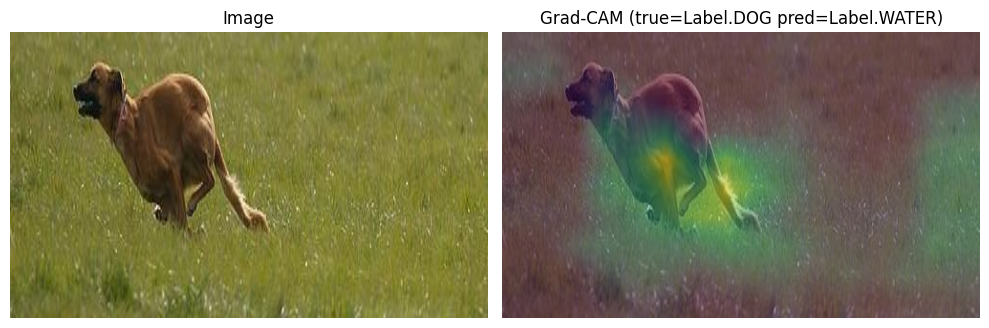


--- Mauvaise prédiction ---
dataset_idx : 326
image      : ../data/final_dataset/new_water/water_502/new_water_502.jpg
vrai label : Label.WATER (3)
prédit     : Label.BALL (0)
caption    : A young boy is playfully splashing his terrier, Max, on a warm summer afternoon in their backyard. The sun beats down on the lush green grass as the boy enthusiastically uses his water gun to give Max a cooling treat, bringing out a joyful bark from the grateful dog. Water droplets glisten on the dog's fur as he eagerly opens his mouth for another squirt.


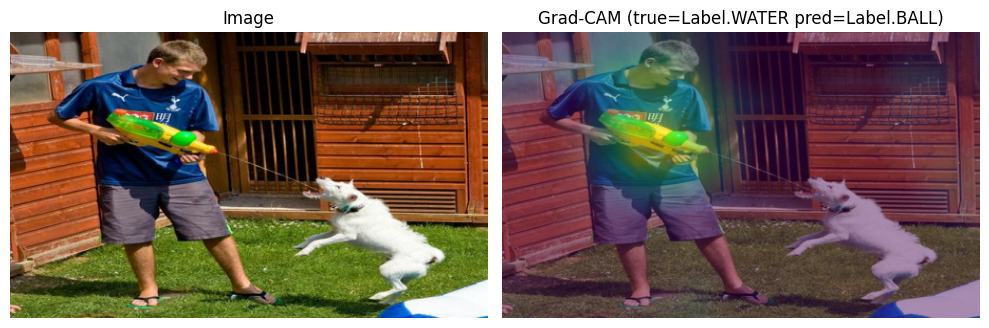


--- Mauvaise prédiction ---
dataset_idx : 18
image      : ../data/final_dataset/new_dog/dog_1052/new_dog_1052.jpg
vrai label : Label.DOG (2)
prédit     : Label.WATER (3)
caption    : The sun casts a warm glow over the lush green field, where a playful brown and white dog frolics with abandon, its tail wagging furiously as it chases after a squeaky toy. The air is filled with the sweet scent of blooming clover, which has sprouted in every direction, creating a soft, velvety carpet underfoot. Nearby, a few wisps of cloud drift lazily across the blue sky, adding to the serene and idyllic atmosphere of this tranquil scene.


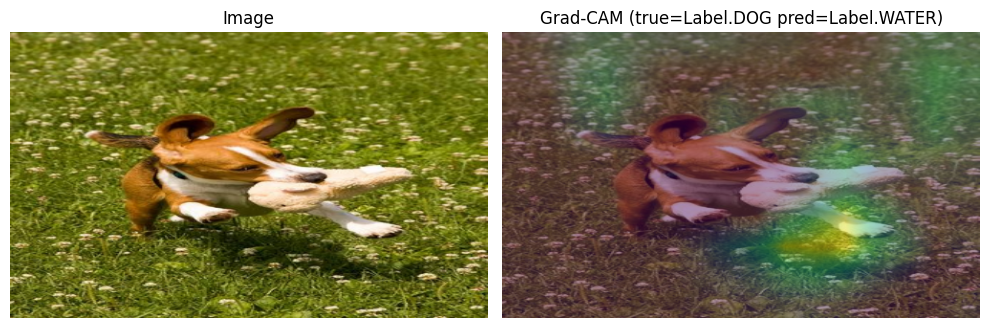


--- Mauvaise prédiction ---
dataset_idx : 391
image      : ../data/final_dataset/new_dog/dog_857/new_dog_857.jpg
vrai label : Label.DOG (2)
prédit     : Label.WATER (3)
caption    : A young boy is seen standing at the base of a blue plastic slide, his eyes fixed on the furry companion perched at the top. The enthusiastic dog's tail wags excitedly as it surveys its surroundings from its elevated position, its paws grasping the slide's edge for balance. A summer afternoon sun shines down upon the scene, casting a warm glow over the joyful moment.


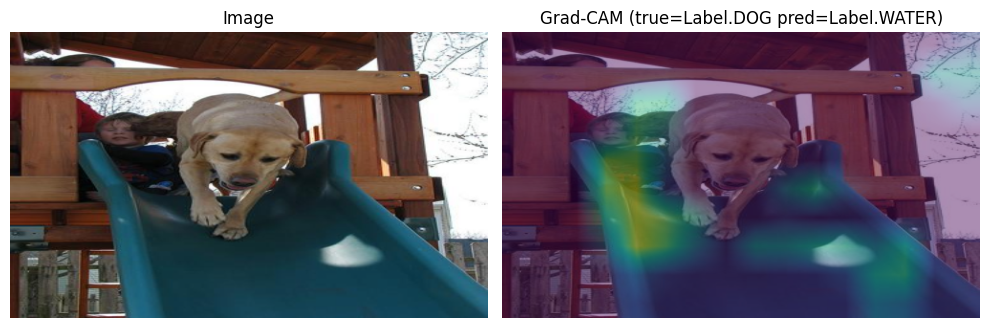


--- Mauvaise prédiction ---
dataset_idx : 349
image      : ../data/final_dataset/new_ball/ball_015/new_ball_015.jpg
vrai label : Label.BALL (0)
prédit     : Label.DOG (2)
caption    : A brown dog, its fur fluffed up from excitement, leaps into the air as it tries to catch a red rubber ball that has bounced onto the vast, sun-kissed plain. The dog's joyful barking echoes across the open terrain as it struggles to corral the elusive ball, which rolls and skips across the dry earth. For a moment, the scene is frozen in time, the only movement the gentle swaying of tall grasses in the breeze.


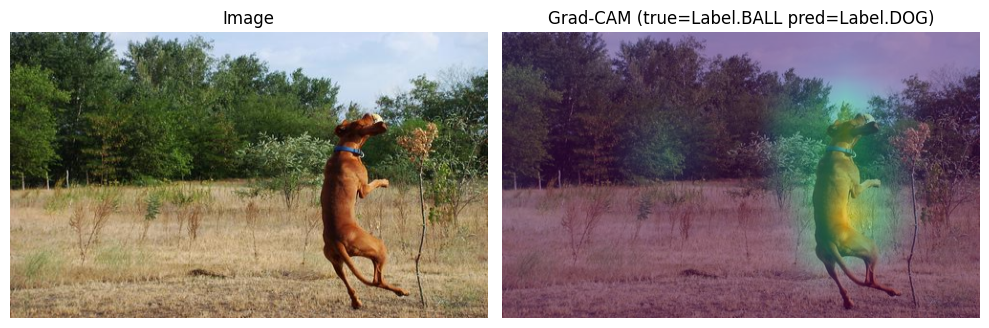


🚀 Training mode: freeze_until_l3


TRAIN epoch 1: 100%|██████████| 92/92 [00:13<00:00,  6.75it/s]


Epoch 1: Train loss = 0.7161


TRAIN epoch 2: 100%|██████████| 92/92 [00:13<00:00,  6.67it/s]


Epoch 2: Train loss = 0.2070


TRAIN epoch 3: 100%|██████████| 92/92 [00:13<00:00,  6.84it/s]


Epoch 3: Train loss = 0.0684


TRAIN epoch 4: 100%|██████████| 92/92 [00:13<00:00,  6.58it/s]


Epoch 4: Train loss = 0.0398


TRAIN epoch 5: 100%|██████████| 92/92 [00:13<00:00,  6.83it/s]


Epoch 5: Train loss = 0.0281

--- Mauvaise prédiction ---
dataset_idx : 265
image      : ../data/final_dataset/new_dog/dog_496/new_dog_496.jpg
vrai label : Label.DOG (2)
prédit     : Label.WATER (3)
caption    : A playful small dog, its fur fluffed up from excitement, leaps effortlessly over a narrow yellow beam lying on the ground in a park. The sun casts a warm glow on the scene as children's laughter and chirping birds fill the air. The dog's joyful yelp echoes through the atmosphere as it lands safely on the other side of the beam.


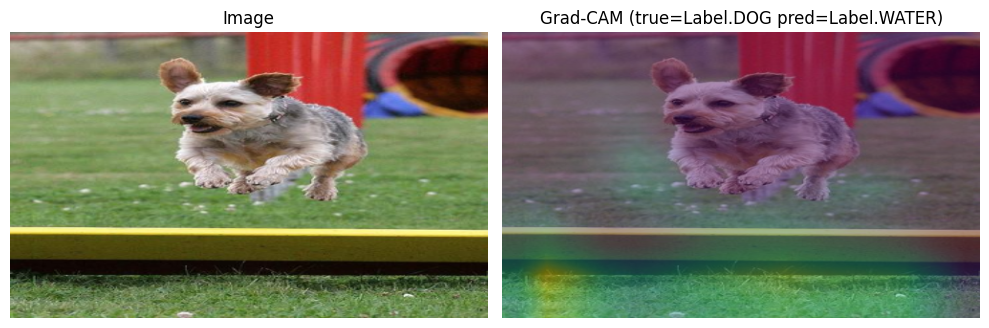


--- Mauvaise prédiction ---
dataset_idx : 37
image      : ../data/final_dataset/new_bike/bike_228/new_bike_228.jpg
vrai label : Label.BIKE (1)
prédit     : Label.DOG (2)
caption    : A rugged dirt trail winds its way through a dense forest, the sun casting dappled shadows on the ground below. A man sits atop his dirt bike, revving up the engine and preparing to take off in a burst of speed. The air is filled with the sound of gravel crunching beneath the tires as he gets ready to launch into a wheelie.


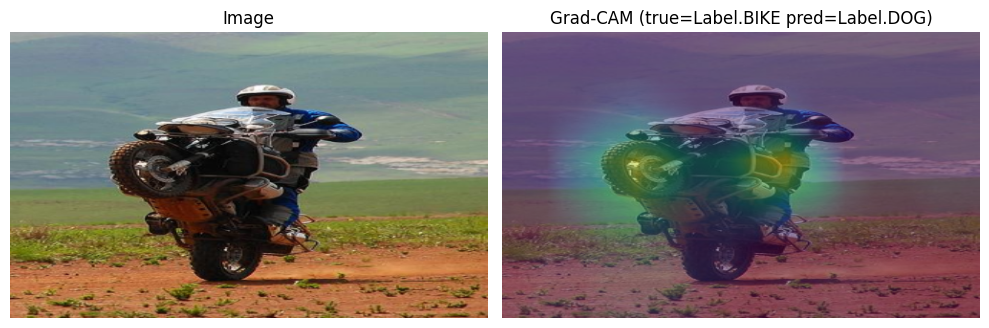


--- Mauvaise prédiction ---
dataset_idx : 311
image      : ../data/final_dataset/new_bike/bike_393/new_bike_393.jpg
vrai label : Label.BIKE (1)
prédit     : Label.WATER (3)
caption    : The sun-dappled forest trail stretched out before him, winding through towering trees as a boy in an orange shirt expertly navigated his dirt bike over roots and rocks. His bright helmet glistened with dew as he picked up speed, the roar of the engine echoing off the tree trunks. A burst of sunlight filtering through the canopy above highlighted the dust kicked up by the bike's tires as it devoured the terrain.


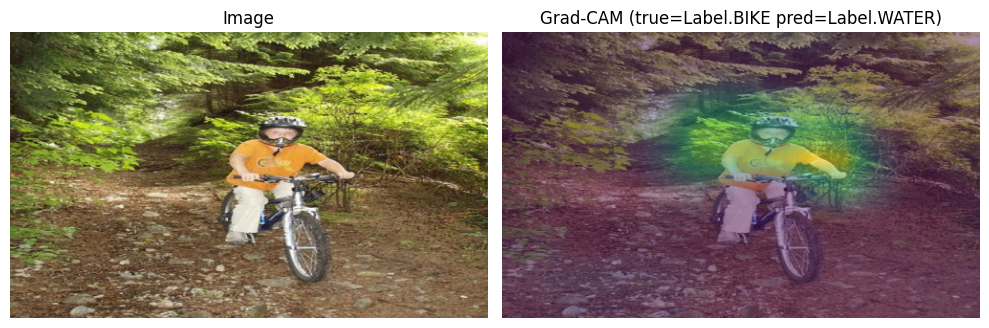


--- Mauvaise prédiction ---
dataset_idx : 441
image      : ../data/final_dataset/new_water/water_907/new_water_907.jpg
vrai label : Label.WATER (3)
prédit     : Label.BALL (0)
caption    : A group of five Asian girls, their dark hair dripping with water, can be seen laughing and playing in the cool mist of a public fountain on a warm summer day. The sound of gently flowing water fills the air as they chase each other around the fountain's central basin, creating a joyful scene that brings smiles to passersby. The sunlight catches the water droplets on their faces, adding a sense of sparkling wonder to the moment.


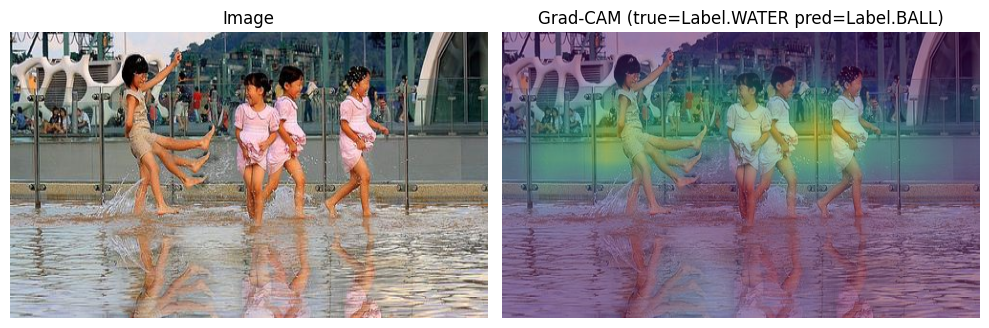


--- Mauvaise prédiction ---
dataset_idx : 61
image      : ../data/final_dataset/new_bike/bike_067/new_bike_067.jpg
vrai label : Label.BIKE (1)
prédit     : Label.WATER (3)
caption    : A young boy, dressed in casual outdoor clothing, sits atop his mountain bike at the top of a winding trail, looking excited to begin his descent. The trail stretches out before him, disappearing into the dense foliage of the surrounding forest. In the background, a few trees can be seen, their leaves rustling gently in the breeze.


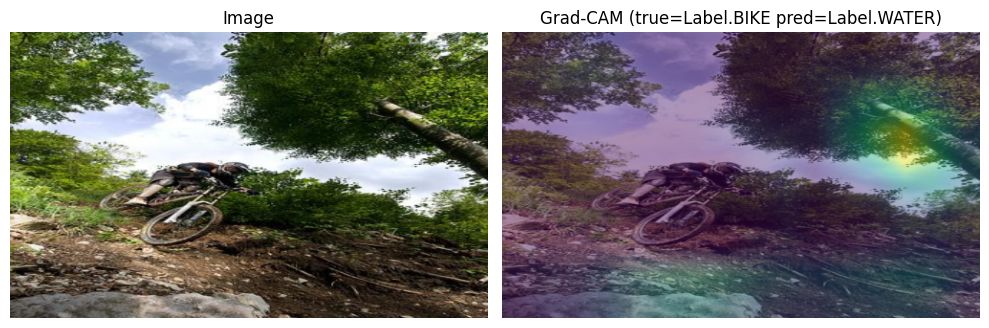


🚀 Training mode: freeze_semantic


TRAIN epoch 1: 100%|██████████| 92/92 [00:17<00:00,  5.31it/s]


Epoch 1: Train loss = 0.8515


TRAIN epoch 2: 100%|██████████| 92/92 [00:17<00:00,  5.31it/s]


Epoch 2: Train loss = 0.3722


TRAIN epoch 3: 100%|██████████| 92/92 [00:17<00:00,  5.32it/s]


Epoch 3: Train loss = 0.1666


TRAIN epoch 4: 100%|██████████| 92/92 [00:17<00:00,  5.35it/s]


Epoch 4: Train loss = 0.0774


TRAIN epoch 5: 100%|██████████| 92/92 [00:17<00:00,  5.21it/s]


Epoch 5: Train loss = 0.0424

--- Mauvaise prédiction ---
dataset_idx : 210
image      : ../data/final_dataset/new_dog/dog_769/new_dog_769.jpg
vrai label : Label.DOG (2)
prédit     : Label.BALL (0)
caption    : In a lush green meadow, a sleek black dog is seen in full sprint, its paws pounding against the soft grass as it plays with abandon. A bright purple collar adorns its neck, while a matching leash lies abandoned on the ground behind it, having clearly been cast aside in the heat of the moment. As the sun shines down upon the scene, the dog's joyful energy is palpable, bringing a sense of carefree joy to all who behold it.


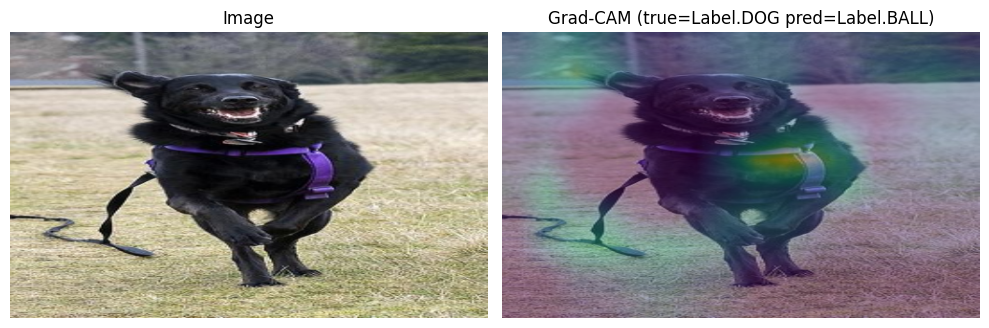


--- Mauvaise prédiction ---
dataset_idx : 254
image      : ../data/final_dataset/new_water/water_1095/new_water_1095.jpg
vrai label : Label.WATER (3)
prédit     : Label.BALL (0)
caption    : A young girl plays in her backyard on a warm summer day, giggling as she tries to avoid getting soaked by the rotating sprinkler spraying cool water everywhere. Her bright orange dress gets drenched in the process, clinging to her legs and making her look like a little mermaid. The sound of the sprinkler creates a soothing melody in the background, accompanied by the chirping of birds in the nearby trees.


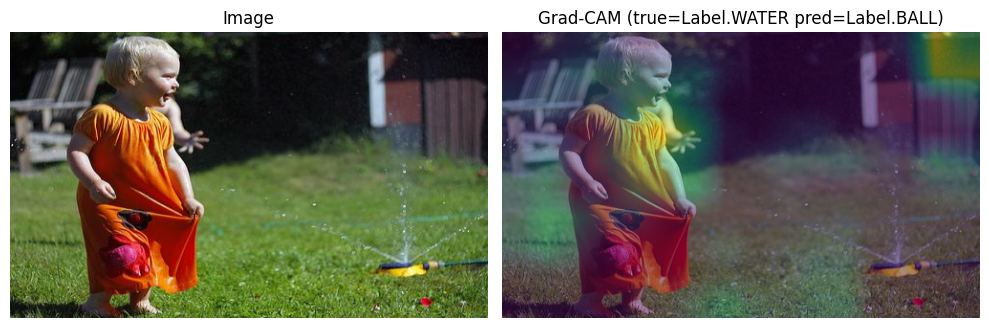


--- Mauvaise prédiction ---
dataset_idx : 285
image      : ../data/final_dataset/new_ball/ball_695/new_ball_695.jpg
vrai label : Label.BALL (0)
prédit     : Label.WATER (3)
caption    : A playful black dog, its fur fluffed up in excitement, stands at the edge of a small pool of water, its paws lifted off the ground as it prepares to leap forward and splash into the water after a small white ball that has just landed with a tiny ripple on the surface. The sun casts a warm glow over the scene, illuminating the dog's joyful expression and the tranquil surroundings. A few leaves from nearby trees are scattered around the pool's edge, adding a touch of natural charm to the scene.


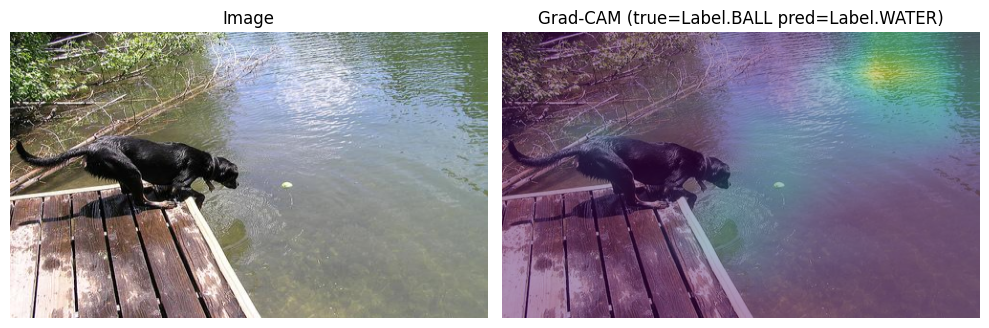


--- Mauvaise prédiction ---
dataset_idx : 102
image      : ../data/final_dataset/new_dog/dog_369/new_dog_369.jpg
vrai label : Label.DOG (2)
prédit     : Label.WATER (3)
caption    : In the warm sunlight, a daschund playfully barks at a bubble making machine set up in the lush green grass of a park, its tongue hanging out of its mouth as it tries to chase after the colorful bubbles floating through the air. The machine is emitting a gentle hum and blowing out an endless stream of iridescent orbs that are dancing on the breeze, captivating the dog's attention and entertaining a small crowd of children playing nearby.


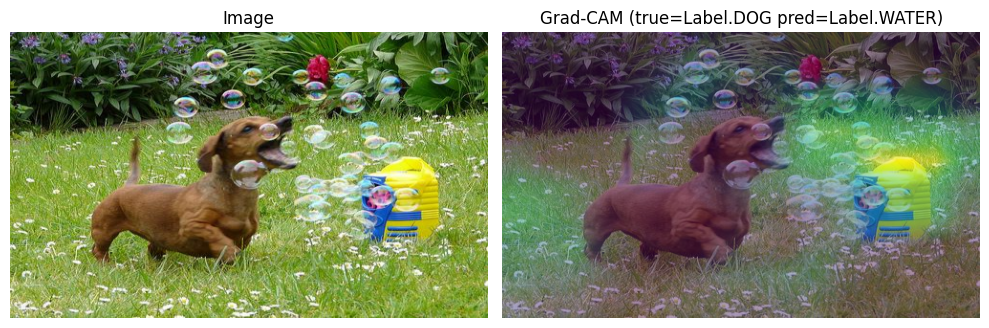


--- Mauvaise prédiction ---
dataset_idx : 226
image      : ../data/final_dataset/new_ball/ball_593/new_ball_593.jpg
vrai label : Label.BALL (0)
prédit     : Label.WATER (3)
caption    : A young boy with glasses perched on the end of his nose stands knee-deep in the warm sand, gazing up at the sky as he expertly tosses a bright yellow ball into the air. The sun casts a gentle glow over the serene scene, illuminating the subtle grains of sand that dance around the boy's feet. For a brief moment, time seems to stand still as the ball soars through its arc, suspended in mid-air like a fleeting promise of joy and carefree abandon.


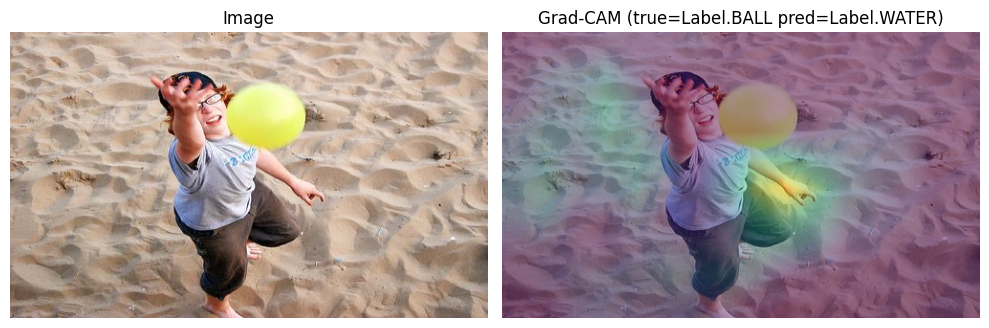


🚀 Training mode: unfreeze_all


TRAIN epoch 1: 100%|██████████| 92/92 [00:18<00:00,  4.97it/s]


Epoch 1: Train loss = 0.6602


TRAIN epoch 2: 100%|██████████| 92/92 [00:17<00:00,  5.20it/s]


Epoch 2: Train loss = 0.1561


TRAIN epoch 3: 100%|██████████| 92/92 [00:18<00:00,  5.09it/s]


Epoch 3: Train loss = 0.0579


TRAIN epoch 4: 100%|██████████| 92/92 [00:18<00:00,  5.11it/s]


Epoch 4: Train loss = 0.0342


TRAIN epoch 5: 100%|██████████| 92/92 [00:18<00:00,  4.93it/s]


Epoch 5: Train loss = 0.0272

--- Mauvaise prédiction ---
dataset_idx : 419
image      : ../data/final_dataset/new_dog/dog_1091/new_dog_1091.jpg
vrai label : Label.DOG (2)
prédit     : Label.WATER (3)
caption    : A snow-covered trail stretches out into the woods, interrupted only by the occasional boulder and the tracks of small animals in the fresh powder. A black and white dog, its fur fluffed up against the cold, is momentarily airborne as it leaps over a particularly large rock in the middle of the path. The scene is bathed in pale winter sunlight that casts long shadows across the snow.


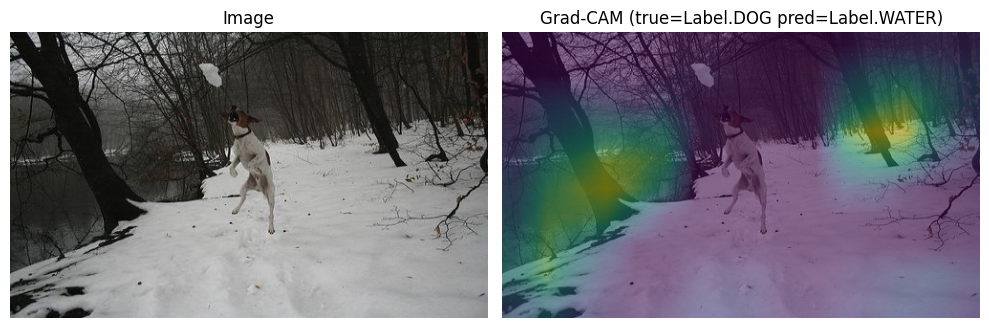


--- Mauvaise prédiction ---
dataset_idx : 122
image      : ../data/final_dataset/new_water/water_898/new_water_898.jpg
vrai label : Label.WATER (3)
prédit     : Label.DOG (2)
caption    : The sun beats down on the sandy shoreline as a brown dog, its fur fluffed up with excitement, runs freely along the beach, the waves gently lapping at its paws. Seagulls soar overhead, their cries carried away by the ocean breeze. In the distance, the horizon stretches out to meet the sky, where the blue expanse of water seems to blend seamlessly into the heavens.


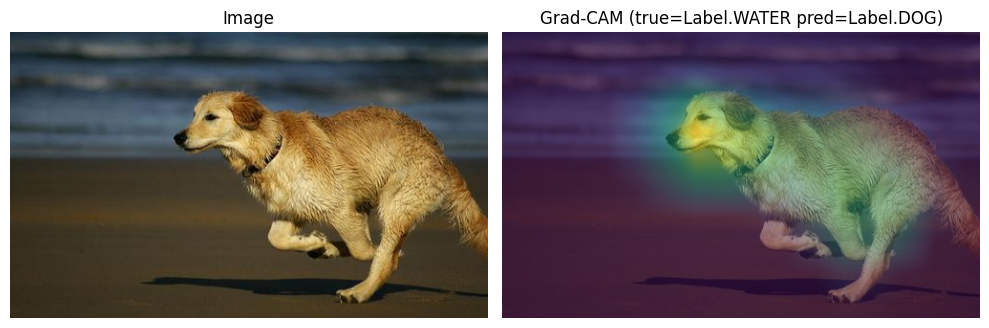


--- Mauvaise prédiction ---
dataset_idx : 107
image      : ../data/final_dataset/new_water/water_1224/new_water_1224.jpg
vrai label : Label.WATER (3)
prédit     : Label.DOG (2)
caption    : A dog splashes playfully in a puddle of murky water, its fur matted with damp mud. The surrounding area appears to be a rural landscape, with tall trees and overgrown bushes visible in the background. A faint mist rises from the surface of the water, casting a subtle veil over the scene.


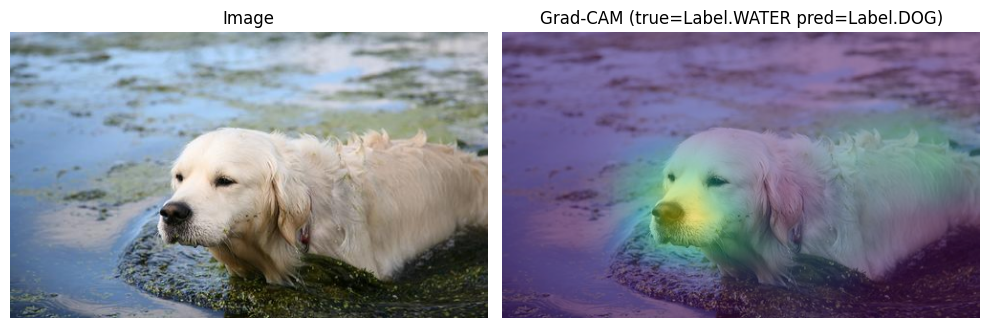


--- Mauvaise prédiction ---
dataset_idx : 537
image      : ../data/final_dataset/new_dog/dog_099/new_dog_099.jpg
vrai label : Label.DOG (2)
prédit     : Label.WATER (3)
caption    : A group of dogs have gathered in a lush green meadow, enjoying the warm sun on their backs. A brown dog with a fluffy coat stands near a black and white one, both seemingly engaged in a playful conversation. Meanwhile, a sleek black dog with a shiny collar ambles by, its tail wagging gently as it surveys the scene.


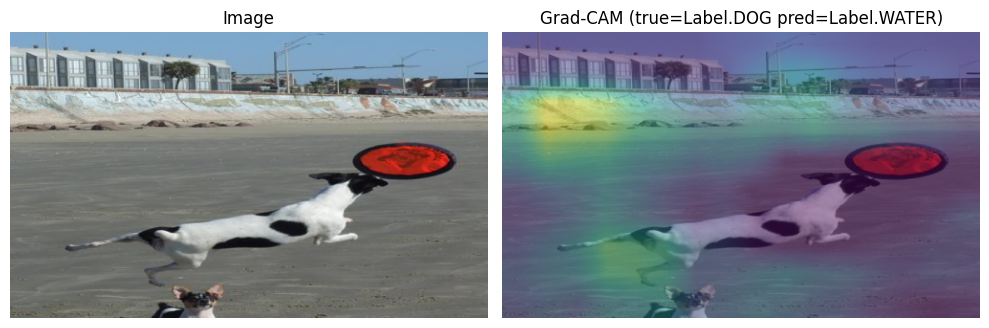


--- Mauvaise prédiction ---
dataset_idx : 512
image      : ../data/final_dataset/new_bike/bike_240/new_bike_240.jpg
vrai label : Label.BIKE (1)
prédit     : Label.WATER (3)
caption    : A young boy is riding his bicycle down a dirt path, building up speed as he approaches the wooden ramp in front of him. With a burst of adrenaline, he launches himself off the ramp, soaring through the air on his bike, capturing the perfect moment just before landing with a gentle thud back on solid ground. The sun casts a warm glow over the entire scene, illuminating the boy's carefree smile as he takes in the thrill of flight.


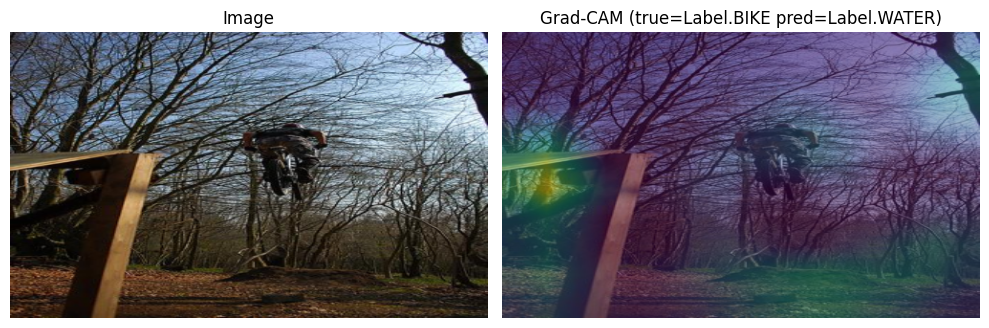

In [94]:
modes = [
    "freeze_all",
    "freeze_until_l3",
    "freeze_semantic",
    "unfreeze_all",
]

for mode in modes:
    print("\n" + "=" * 50)
    print(f"🚀 Training mode: {mode}")
    print("=" * 50)

    model_resnet_freeze = resnet18(weights=ResNet18_Weights.IMAGENET1K_V1)
    model_resnet_freeze.fc = nn.Linear(model_resnet_freeze.fc.in_features, num_classes)

    optimizer = configure_finetuning(model_resnet_freeze, mode=mode)

    train_one_experiment(
        model=model_resnet_freeze,
        train_loader=train_loader_resnet,
        optimizer=optimizer,
        criterion=criterion,
        device=device,
        epochs=5
    )

    

    target_layer = model_resnet_freeze.layer4[-1]

    show_5_mistakes_with_gradcam(
        model=model_resnet_freeze,
        loader=train_loader_custom_noaug,
        device=device,
        class_names=class_name_resnet,
        target_layer=target_layer,
        dataset=train_dataset_custom_noaug,
        n=5
    )

### CLASSIIFCATION THIRD LAYER

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.models import resnet18, ResNet18_Weights

class ResNet18Layer3Classifier(nn.Module):
    def __init__(self, num_classes=4, weights=ResNet18_Weights.IMAGENET1K_V1):
        super().__init__()
        base = resnet18(weights=weights)

        # backbone jusqu'à layer3
        self.conv1 = base.conv1
        self.bn1 = base.bn1
        self.relu = base.relu
        self.maxpool = base.maxpool
        self.layer1 = base.layer1
        self.layer2 = base.layer2
        self.layer3 = base.layer3

        # head sur layer3 (channels = 256 pour ResNet18)
        self.pool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(256, num_classes)

    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)

        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)

        x = self.pool(x).flatten(1)
        logits = self.fc(x)
        return logits


In [2]:
model_l3 = ResNet18Layer3Classifier(num_classes=4).to(device)

optimizer = optim.Adam(model_l3.parameters(), lr=1e-4, weight_decay=1e-5)
criterion = nn.CrossEntropyLoss()

for epoch in range(11):
    model_l3.train()
    running_loss = 0.0

    for idx, inputs, labels, caption in tqdm(train_loader_resnet, desc=f"TRAIN {epoch+1}"):
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        logits = model_l3(inputs)
        loss = criterion(logits, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f"Epoch {epoch+1}: Train loss = {running_loss/len(train_loader_resnet):.4f}")


NameError: name 'num_classes' is not defined

Epoch 1/1 [EVAL]: 100%|██████████| 18/18 [00:02<00:00,  8.03it/s]


Best model - TEST loss: 0.1008
Accuracy : 0.9732142686843872



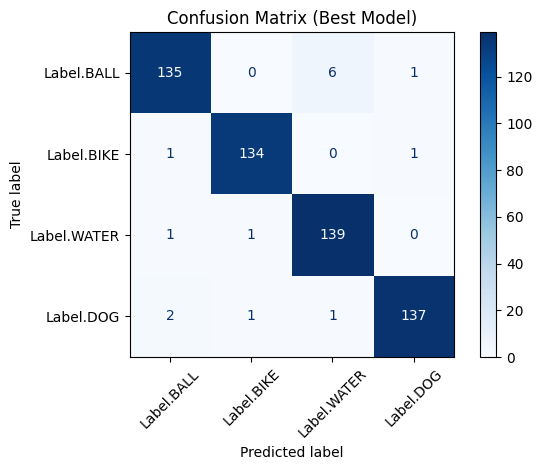

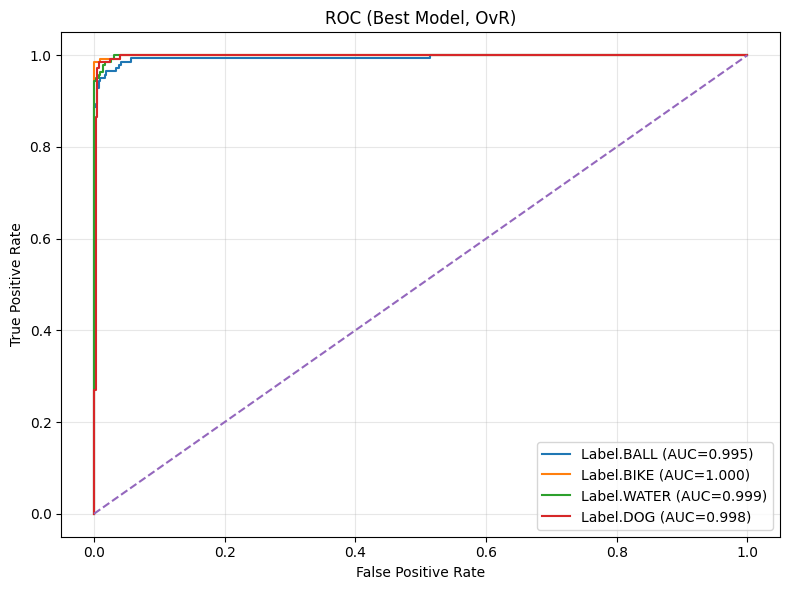

In [84]:

final_test_loss, y_true, y_pred, y_prob, acc = evaluate(
    model_l3, train_loader_resnet_noaug, criterion, device, epoch=0, epochs=1, num_classes=num_classes
)
print(f"Best model - TEST loss: {final_test_loss:.4f}")
print(f"Accuracy : {acc}\n")
plot_confusion_matrix(y_true, y_pred, class_names=class_names, title="Confusion Matrix (Best Model)")
plot_multiclass_roc(y_true, y_prob, num_classes=4, class_names=class_names, title="ROC (Best Model, OvR)")

### WEIRD SHIT

Collect misclassified:   0%|          | 0/20 [00:00<?, ?it/s]

Nb mauvaises prédictions (VAL): 63


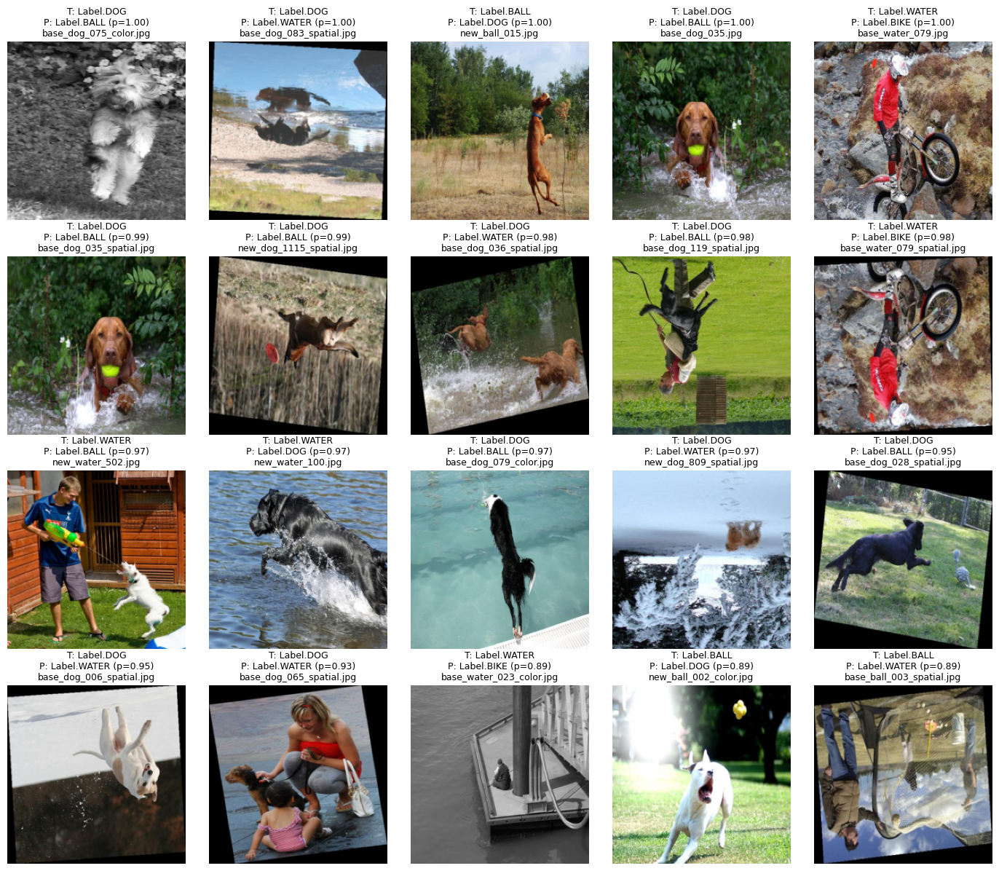

In [ ]:
IMAGENET_MEAN = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
IMAGENET_STD  = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)

def denorm_img(x: torch.Tensor) -> torch.Tensor:
    x = x.detach().cpu() * IMAGENET_STD + IMAGENET_MEAN
    return x.clamp(0, 1)

def collect_misclassified(model, loader, dataset, device):
    model.eval()
    mis = []

    with torch.no_grad():
        for idxs, inputs, labels in tqdm(loader, desc="Collect misclassified", leave=False):
            # idxs reste CPU
            inputs = inputs.to(device)
            labels = labels.to(device)

            output = model(inputs)
            if isinstance(output, (tuple, list)):
                logits = next((o for o in output if isinstance(o, torch.Tensor)), output[0])
            else:
                logits = output

            probs = torch.softmax(logits, dim=1)
            preds = probs.argmax(dim=1)
            wrong_mask_cpu = preds.ne(labels).detach().cpu()

            if wrong_mask_cpu.any():
                wrong_idxs  = idxs[wrong_mask_cpu].cpu().tolist()
                wrong_imgs  = inputs.detach().cpu()[wrong_mask_cpu]   # inputs est GPU -> on cpu puis masque cpu
                wrong_true  = labels.detach().cpu()[wrong_mask_cpu].tolist()
                wrong_pred  = preds.detach().cpu()[wrong_mask_cpu].tolist()
                wrong_probs = probs.detach().cpu().numpy()[wrong_mask_cpu.numpy()]

                for j, ds_idx in enumerate(wrong_idxs):
                    path = dataset._get_img_path_from_idx(ds_idx)
                    mis.append({
                        "idx": int(ds_idx),
                        "path": path,
                        "img": wrong_imgs[j],            
                        "true": int(wrong_true[j]),
                        "pred": int(wrong_pred[j]),
                        "pred_prob": float(wrong_probs[j][wrong_pred[j]]),
                        "true_prob": float(wrong_probs[j][wrong_true[j]]),
                        "probs": wrong_probs[j],
                    })

    return mis

def show_misclassified(mis, idx_to_class, max_images=16, ncols=4, figsize=(14, 12),
                      sort_by="pred_prob", descending=True):

    if sort_by is not None:
        mis = sorted(mis, key=lambda d: d.get(sort_by, 0.0), reverse=descending)

    n = min(len(mis), max_images)
    nrows = int(np.ceil(n / ncols))

    plt.figure(figsize=figsize)
    for i in range(n):
        item = mis[i]
        img = denorm_img(item["img"])
        img_np = img.permute(1, 2, 0).numpy()

        plt.subplot(nrows, ncols, i + 1)
        plt.imshow(img_np)
        plt.title(
            f"T: {idx_to_class[item['true']]}\n"
            f"P: {idx_to_class[item['pred']]} (p={item['pred_prob']:.2f})\n"
            f"{item['path'].name}",
            fontsize=9
        )
        plt.axis("off")

    plt.tight_layout()
    plt.show()

# ---- Utilisation ----
idx_to_class = {v: k for k, v in val_dataset_noaug.class_to_idx.items()}

mis_val = collect_misclassified(model_resnet_custom, val_loader_noaug, val_dataset_noaug, device)
print("Nb mauvaises prédictions:", len(mis_val))

show_misclassified(mis_val, idx_to_class, max_images=20, ncols=5, sort_by="pred_prob", descending=True)
